# FX trends and external balance headwinds

This notebook serves as an illustration of the points discussed in the post ["FX trend following and macro headwinds"](https://research.macrosynergy.com/fx-and-macro-headwinds/) available on the Macrosynergy website. 

The post argues that macroeconomic data can provide valuable insights into the headwinds or tailwinds that may affect the continuation of market price trends. In the FX space, for example, the sustainability of a positive return trend in a currency is less likely if concurrent economic data suggest a deterioration in the competitiveness of the local economy. These macro indicators of setback risk may not be easily detected using traditional statistical methods for identifying return predictors, as their effects can compete with dominant trends and exhibit non-linear and concentrated patterns.

To address this issue, the post suggests adjusting standard global FX trend-following strategies to account for changes in external balances. Empirical evidence supports the idea that such adjustments can significantly enhance the performance of FX trend following. In particular,  the post compares the predictive power and economic value of the standard trend and the external balance dynamics scores separately, concluding that both are complimentary. It then considers two types of trend adjustment:

- modifying the original trend signal by multiplying it with a coefficient based on the external dynamics score
- averaging the original trend and external balance dynamics z-score.

The post concludes, that external balance adjustment for FX trend following strategy provides considerable economic value. The effect is particularly pronounced for emerging economies.  

This notebook provides the essential code required to replicate the analysis discussed in the post. 

# Imports

This notebook primarily relies on the standard packages available in the Python data science stack. However, there is an additional package `macrosynergy` that is required for two purposes:

- Downloading JPMaQS data: The `macrosynergy` package facilitates the retrieval of JPMaQS data, which is used in the notebook.
- For the analysis of quantamental data and value propositions: The `macrosynergy` package provides functionality for performing quick analyses of quantamental data and exploring value propositions.

For detailed information and a comprehensive understanding of the `macrosynergy` package and its functionalities, please refer to the ["Introduction to Macrosynergy package"](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php) on the Macrosynergy Academy or visit the following link on [Kaggle](https://www.kaggle.com/code/macrosynergy/introduction-to-macrosynergy-package).

To install the latest version of the package please use the command *pip install macrosynergy --upgrade*

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


import macrosynergy.management as msm
import macrosynergy.panel as msp
import macrosynergy.signal as mss
import macrosynergy.pnl as msn
from macrosynergy.download import JPMaQSDownload


from datetime import timedelta, date, datetime
from itertools import combinations
import warnings
import os

warnings.simplefilter("ignore")

The JPMaQS indicators we consider are downloaded using the J.P. Morgan Dataquery API interface within the `macrosynergy` package. This is done by specifying ticker strings, formed by appending an indicator category code <category> to a currency area code <cross_section>. These constitute the main part of a full quantamental indicator ticker, taking the form `DB(JPMAQS,<cross_section>_<category>,<info>)`, where <info> denotes the time series of information for the given cross-section and category. The following types of information are available:

`value` giving the latest available values for the indicator
`eop_lag` referring to days elapsed since the end of the observation period
`mop_lag` referring to the number of days elapsed since the mean observation period
`grade` denoting a grade of the observation, giving a metric of real-time information quality.

After instantiating the `JPMaQSDownload` class within the `macrosynergy.download` module, one can use the `download(tickers,start_date,metrics)` method to easily download the necessary data, where `tickers` is an array of ticker strings, `start_date` is the first collection date to be considered and `metrics` is an array comprising the times series information to be downloaded. For more information see [here](https://github.com/macrosynergy/macrosynergy/blob/develop/README.md).

To ensure reproducibility, only samples between January 2000 (inclusive) and May 2023 (exclusive) are considered.

In [2]:
# General cross-sections lists

cids_g3 = ["EUR", "JPY", "USD"]  # DM large currency areas
cids_dmsc = ["AUD", "CAD", "CHF", "GBP", "NOK", "NZD", "SEK"]  # DM small currency areas
cids_latm = ["BRL", "COP", "CLP", "MXN", "PEN"]  # Latam
cids_emea = ["CZK", "HUF", "ILS", "PLN", "RON", "RUB", "TRY", "ZAR"]  # EMEA
cids_emas = ["IDR", "INR", "KRW", "MYR", "PHP", "SGD", "THB", "TWD"]  # EM Asia ex China

cids_dm = cids_g3 + cids_dmsc
cids_em = cids_latm + cids_emea + cids_emas
cids = cids_dm + cids_em

# FX cross-section lists

cids_nofx = ["EUR", "USD", "SGD", "RUB"]  # not suitable for analysis
cids_fx = list(set(cids) - set(cids_nofx))

cids_dmfx = list(set(cids_dm).intersection(cids_fx))
cids_emfx = list(set(cids_em).intersection(cids_fx))

cids_eur = ["CHF", "CZK", "HUF", "NOK", "PLN", "RON", "SEK"]  # trading against EUR
cids_eud = ["GBP", "TRY"]  # trading against EUR and USD
cids_usd = list(set(cids_fx) - set(cids_eur + cids_eud))  # trading against USD

In [3]:
# Category tickers

xbts = [  # long-term trends
    "BXBGDPRATIO_NSA_12MMAv60MMA",
    "BXBGDPRATIO_NSA_12MMAv120MMA",
    "MTBGDPRATIO_SA_3MMAv24MMA",
    "MTBGDPRATIO_SA_3MMAv60MMA",
    "MTBGDPRATIO_SA_3MMAv120MMA",
]

xbds = [  # shorter-term dynamcis
    "BXBGDPRATIO_NSA_12MMA_D1M1ML3",
    "MTBGDPRATIO_SA_3MMA_D1M1ML3",
    "MTBGDPRATIO_SA_6MMA_D1M1ML6",
    "MTBGDPRATIO_NSA_12MMA_D1M1ML3",
]

main = xbts + xbds

rets = [
    "FXXR_NSA",
    "FXXR_VT10",
    "FXXRHvGDRB_NSA",
    "EQXR_NSA",
    "FXTARGETED_NSA",
    "FXUNTRADABLE_NSA",
]

xcats = main + rets

# Resultant tickers

tickers = [cid + "_" + xcat for cid in cids for xcat in xcats]
print(f"Maximum number of tickers is {len(tickers)}")

Maximum number of tickers is 465


The description of each JPMaQS category is available under [Macro quantamental academy](https://academy.macrosynergy.com/quantamental-indicators/), or [JPMorgan Markets](https://markets.jpmorgan.com/#jpmaqs) (password protected). For tickers used in this notebook see [External ratios trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/External%20ratios%20trends.php), [FX forward returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/FX%20forward%20returns.php), and [Equity index future returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/Equity%20index%20future%20returns.php).

In [4]:
# Download series from J.P. Morgan DataQuery by tickers

start_date = "2000-01-01"
end_date = "2023-05-01"

# Retrieve credentials

client_id: str = os.getenv("DQ_CLIENT_ID")
client_secret: str = os.getenv("DQ_CLIENT_SECRET")

with JPMaQSDownload(client_id=client_id, client_secret=client_secret) as dq:
    df = dq.download(
        tickers=tickers,
        start_date=start_date,
        end_date=end_date,
        suppress_warning=True,
        metrics=["all"],
        report_time_taken=True,
        show_progress=True,
    )

Timestamp UTC:  2024-03-27 12:16:16
Connection successful!


Requesting data: 100%|██████████| 93/93 [00:20<00:00,  4.51it/s]


Time taken to download data: 	44.98 seconds.
Some expressions are missing from the downloaded data. Check logger output for complete list.
68 out of 1860 expressions are missing. To download the catalogue of all available expressions and filter the unavailable expressions, set `get_catalogue=True` in the call to `JPMaQSDownload.download()`.


In [5]:
dfx = df.copy()
display(dfx["xcat"].unique())
display(dfx["cid"].unique())
dfx["ticker"] = dfx["cid"] + "_" + dfx["xcat"]
# dfx.head(3)

array(['BXBGDPRATIO_NSA_12MMA_D1M1ML3', 'BXBGDPRATIO_NSA_12MMAv60MMA',
       'FXTARGETED_NSA', 'FXUNTRADABLE_NSA', 'FXXRHvGDRB_NSA', 'FXXR_NSA',
       'FXXR_VT10', 'MTBGDPRATIO_NSA_12MMA_D1M1ML3',
       'MTBGDPRATIO_SA_3MMA_D1M1ML3', 'MTBGDPRATIO_SA_3MMAv24MMA',
       'MTBGDPRATIO_SA_3MMAv60MMA', 'MTBGDPRATIO_SA_6MMA_D1M1ML6',
       'EQXR_NSA', 'MTBGDPRATIO_SA_3MMAv120MMA',
       'BXBGDPRATIO_NSA_12MMAv120MMA'], dtype=object)

array(['AUD', 'BRL', 'CAD', 'CHF', 'CLP', 'COP', 'CZK', 'EUR', 'GBP',
       'HUF', 'IDR', 'ILS', 'INR', 'JPY', 'KRW', 'MXN', 'MYR', 'NOK',
       'NZD', 'PEN', 'PHP', 'PLN', 'RON', 'RUB', 'SEK', 'SGD', 'THB',
       'TRY', 'TWD', 'USD', 'ZAR'], dtype=object)

In [6]:
scols = ["cid", "xcat", "real_date", "value"]  # required columns
dfx = df[scols].copy()
dfx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2618715 entries, 0 to 2618714
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   cid        object        
 1   xcat       object        
 2   real_date  datetime64[ns]
 3   value      float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 79.9+ MB


## Blacklist dictionaries

Identifying and isolating periods of official exchange rate targets, illiquidity, or convertibility-related distortions in FX markets is the first step in creating an FX trading strategy. These periods can significantly impact the behavior and dynamics of currency markets, and failing to account for them can lead to inaccurate or misleading findings. 

In [7]:
dfb = df[df["xcat"].isin(["FXTARGETED_NSA", "FXUNTRADABLE_NSA"])].loc[
    :, ["cid", "xcat", "real_date", "value"]
]
dfba = (
    dfb.groupby(["cid", "real_date"])
    .aggregate(value=pd.NamedAgg(column="value", aggfunc="max"))
    .reset_index()
)
dfba["xcat"] = "FXBLACK"
fxblack = msp.make_blacklist(dfba, "FXBLACK")
fxblack

{'BRL': (Timestamp('2012-12-03 00:00:00'), Timestamp('2013-09-30 00:00:00')),
 'CHF': (Timestamp('2011-10-03 00:00:00'), Timestamp('2015-01-30 00:00:00')),
 'CZK': (Timestamp('2014-01-01 00:00:00'), Timestamp('2017-07-31 00:00:00')),
 'ILS': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-12-30 00:00:00')),
 'INR': (Timestamp('2000-01-03 00:00:00'), Timestamp('2004-12-31 00:00:00')),
 'MYR_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2007-11-30 00:00:00')),
 'MYR_2': (Timestamp('2018-07-02 00:00:00'), Timestamp('2023-05-01 00:00:00')),
 'PEN': (Timestamp('2021-07-01 00:00:00'), Timestamp('2021-07-30 00:00:00')),
 'RON': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_2': (Timestamp('2022-02-01 00:00:00'), Timestamp('2023-05-01 00:00:00')),
 'SGD': (Timestamp('2000-01-03 00:00:00'), Timestamp('2023-05-01 00:00:00')),
 'THB': (Timestamp('2007-01-01 00:00:00'), Timestamp('20

## Availability

It is important to assess data availability before conducting any analysis. It allows identifying any potential gaps or limitations in the dataset, which can impact the validity and reliability of analysis and ensure that a sufficient number of observations for each selected category and cross-section is available as well as determining the appropriate time periods for analysis. 

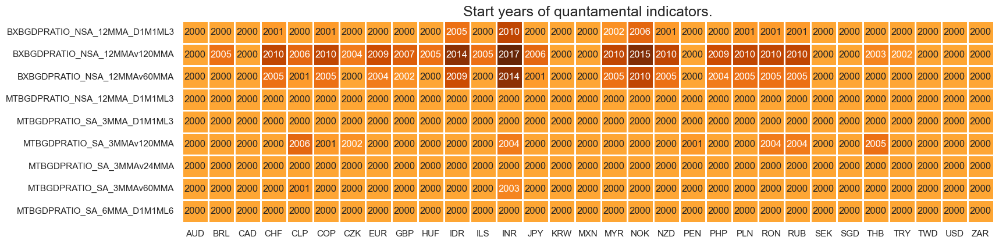

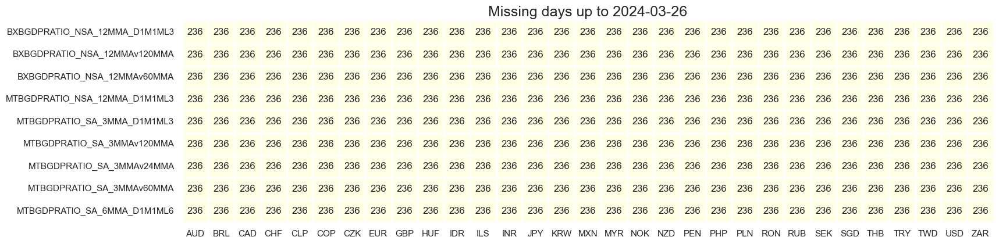

In [8]:
msm.check_availability(df, xcats=main, cids=cids)

# Transformations and checks

## Features

### Long-term external ratios trends

We start with collecting and displaying [longer-term basic external balances trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/External%20ratios%20trends.php) on a timeline:  

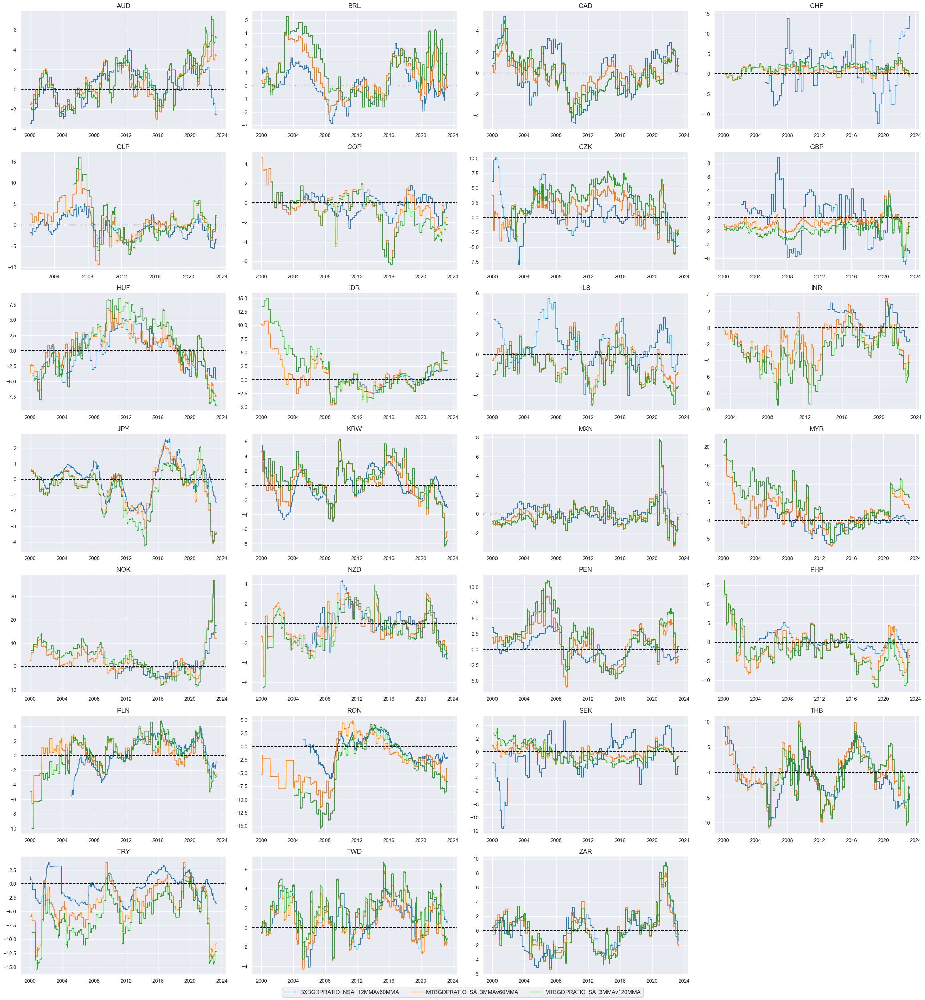

In [9]:
xcatx = [
    "BXBGDPRATIO_NSA_12MMAv60MMA",  # Basic external balance (current account plus net FDI trend), as % of GDP: 1-year average versus 5-year average
    "MTBGDPRATIO_SA_3MMAv60MMA",  # Merchandise trade balance, seasonally adjusted, as % of nominal GDP latest 3 months versus 5-year average
    "MTBGDPRATIO_SA_3MMAv120MMA",  # Merchandise trade balance, seasonally adjusted, as % of nominal GDP latest 3 months versus 10-year average
]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
  )

Next, we combine to simple trend averages with equal weights for all constituents and create the new trend indicator `XBTREND_AVG`:

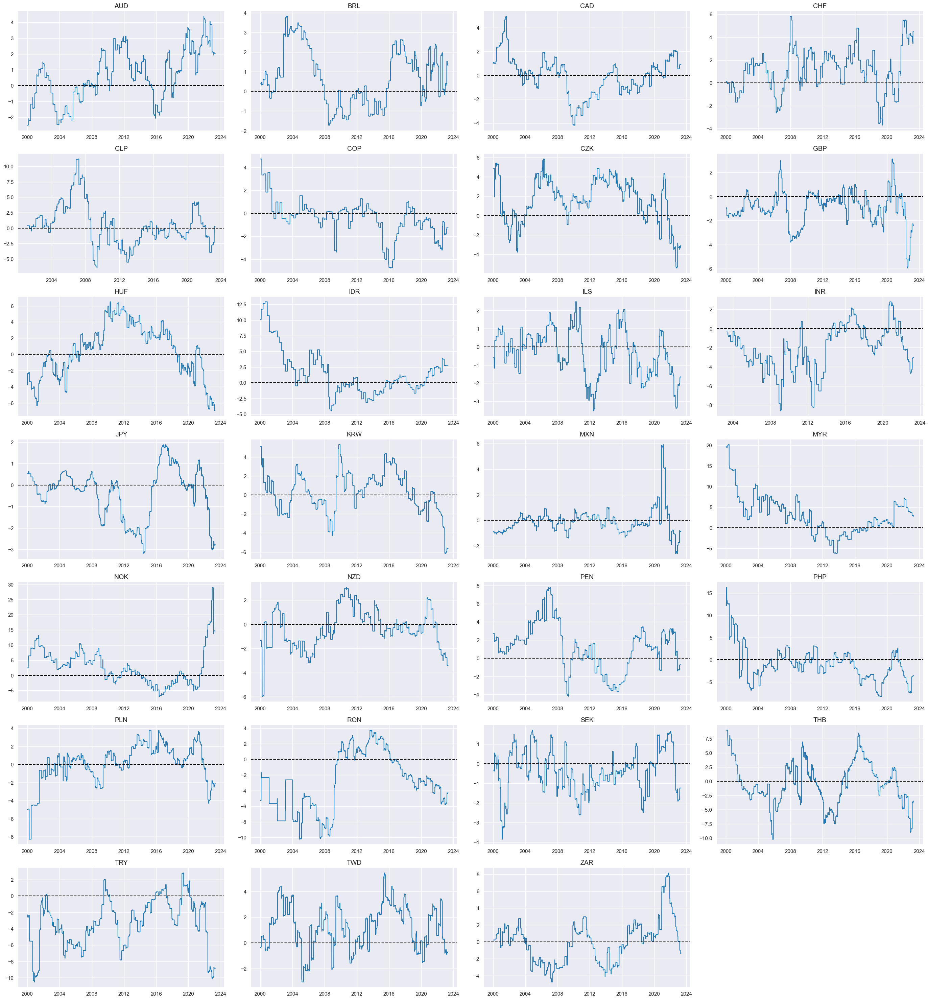

In [10]:
dix = {
    "BXBGDPRATIO_NSA_12MMAv60MMA": 1 / 3,
    "MTBGDPRATIO_SA_3MMAv60MMA": 1 / 3,
    "MTBGDPRATIO_SA_3MMAv120MMA": 1 / 3,
}
cidx = cids_fx

dfa = msp.linear_composite(
    dfx,
    xcats=list(dix.keys()),
    weights=list(dix.values()),
    cids=cidx,
    complete_xcats=False,
    new_xcat="XBTREND_AVG",
)
dfx = msm.update_df(dfx, dfa)

xcatx = ["XBTREND_AVG"]

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
   )

### Short-term external ratio changes

Separately we collect [medium-term trade balance trends and basic external balance trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/External%20ratios%20trends.php), and also display them on a timeline:

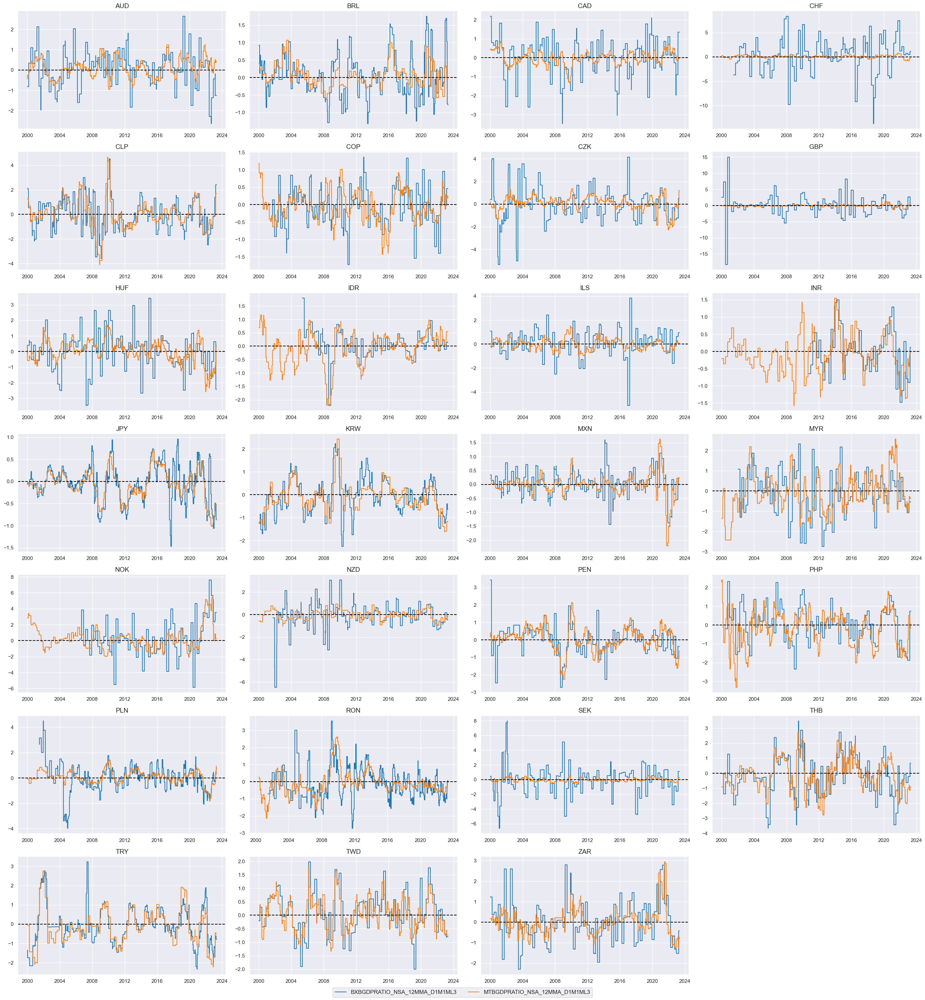

In [11]:
xcatx = [
    "BXBGDPRATIO_NSA_12MMA_D1M1ML3",  # Basic external balance as % of nominal GDP, 1-year moving average. change over the last three reported months.
    "MTBGDPRATIO_NSA_12MMA_D1M1ML3",
]  # Merchandise trade balance as % of nominal GDP, 1-year moving average, change over last three reported months.
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
   
)

Here we collect two [short-term trade balance trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/External%20ratios%20trends.php): 3m/3m and 6m/6m and display them on a timeline:

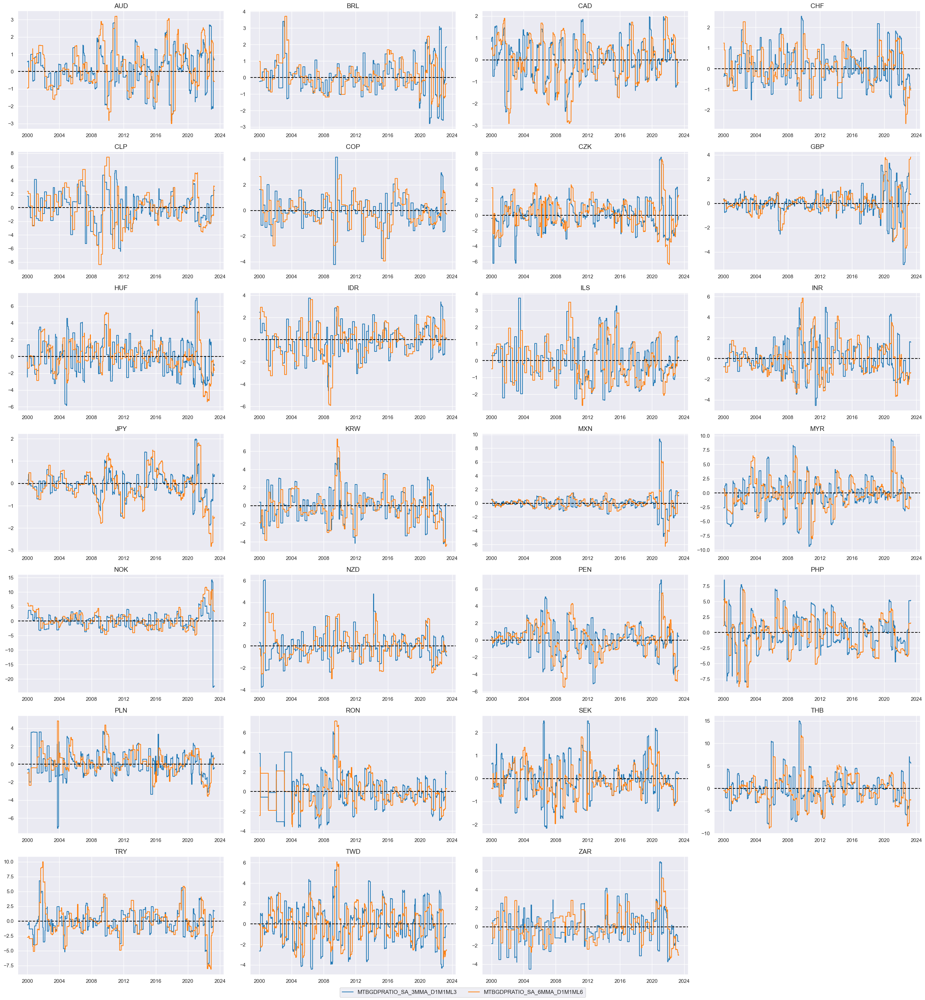

In [12]:
xcatx = [
    "MTBGDPRATIO_SA_3MMA_D1M1ML3",  # Merchandise trade balance as % of nominal GDP, 3-month moving average over previous 3 months.
    "MTBGDPRATIO_SA_6MMA_D1M1ML6",  # Merchandise trade balance as % of nominal GDP, 6-month moving average over previous 6 months.
]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title_adj=0.95,
    label_adj=0.05,
)

To standardize the variables for later comparisons and aggregations, we normalize them (create z-scores) and then average the indicators, giving effectively equal weights to all constituents (except for the two short-term trade balance changes, which are highly correlated and count as one): 

In [13]:
xcatx = xbds  # shorter term dynamics
cidx = cids_fx

dfa = pd.DataFrame(columns=dfx.columns)
for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=522,  # oos scaling after 2 years of panel data
        est_freq="m",
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="_ZN",
    )
    dfa = msm.update_df(dfa, dfaa)
dfx = msm.update_df(dfx, dfa)

In [14]:
dix = {
    "BXBGDPRATIO_NSA_12MMA_D1M1ML3_ZN": 1 / 3,
    "MTBGDPRATIO_NSA_12MMA_D1M1ML3_ZN": 1 / 3,
    "MTBGDPRATIO_SA_3MMA_D1M1ML3_ZN": 1 / 6,
    "MTBGDPRATIO_SA_6MMA_D1M1ML6_ZN": 1 / 6,
}
cidx = cids_fx

dfa = msp.linear_composite(
    dfx,
    xcats=list(dix.keys()),
    weights=list(dix.values()),
    cids=cidx,
    complete_xcats=False,
    new_xcat="XBDYNZ_AVG",
)
dfx = msm.update_df(dfx, dfa)

Here we display the newly created composite measure of shorter-term dynamics indicator `XBDYNZ_AVG` on a timeline. The letter `Z` in the name indicates that it is normalized around zero:

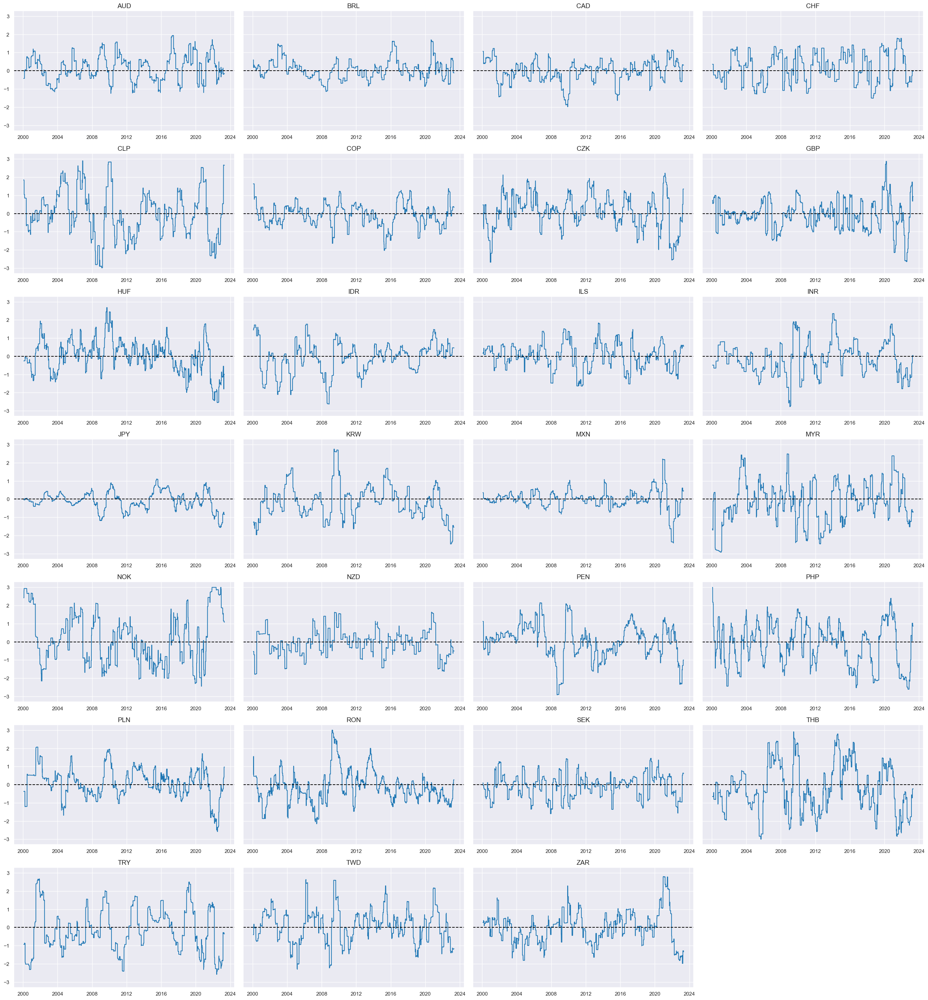

In [15]:
xcatx = [
    "XBDYNZ_AVG",
]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
    
)

### External strength scores

Next, we normalize values across both newly created trend and dynamics indicators  `XBTREND_AVG`, and `XBDYNZ_AVG`. We compute z-scores for a category panel around zero, using monthly re-estimation frequency. For convenience and to be able to use potentially more indicators we create a dictionary of indicators using "T" as an indicator for trend (long-term average external ratios) and "D" for dynamics (short-term external ratio changes). To distinguish modified z-scored indicators from previously created ones, the newly created indicators receive postfix `_ZN` (`XBDYNZ_AVG_ZN` and `XBTREND_AVG_ZN`)

In [16]:
d_xs = {
    "T": "XBTREND_AVG",
    "D": "XBDYNZ_AVG",
}

xcatx = d_xs.values()
cidx = cids_fx

dfa = pd.DataFrame(columns=dfx.columns)
for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=522,  # oos scaling after 2 years of panel data
        est_freq="m",
        neutral="zero",
        pan_weight=1,
        thresh=5,
        postfix="_ZN",
    )
    dfa = msm.update_df(dfa, dfaa)
dfx = msm.update_df(dfx, dfa)

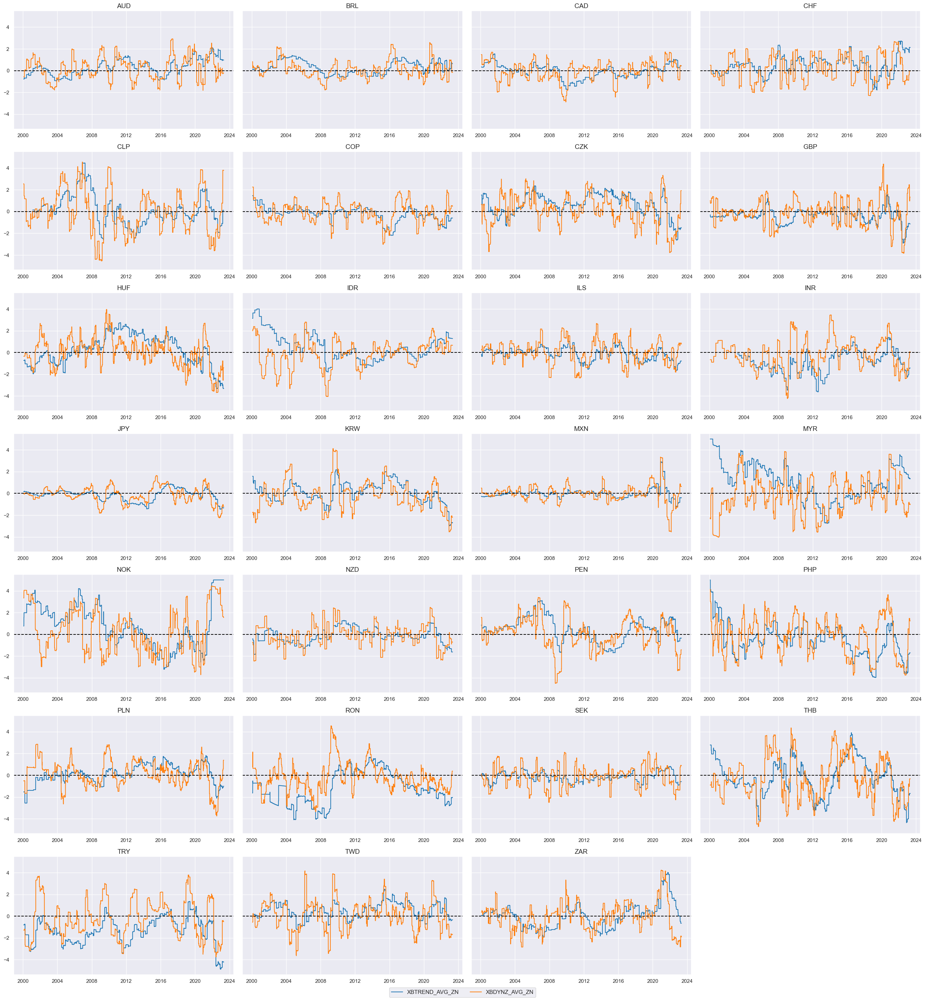

In [17]:
xcatx = [xc + "_ZN" for xc in d_xs.values()]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  )

Here we create possible linear combinations of the two factors and call them `XSD_ZC`, `XSTD_ZC`, and `XST_ZC`. These combinations are effectively possible averages 

In [18]:
# Collect all cycle external strength key combinations, i.e. T, D, TD (Trend, Dynamics, Trend+Dynamics)

xs_combs = [combo for r in range(1, 3) for combo in combinations(d_xs.keys(), r)]

# Use key combinations to calculate all possible factor combinations

dfa = pd.DataFrame(columns=dfx.columns).reindex([])

for xs in xs_combs:
    xcatx = [
        d_xs[i] + "_ZN" for i in xs
    ]  # extract absolute or relative category combination
    cidx = cids_fx
    dfaa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,  # if some categories are missing the score is based on the remaining categories
        new_xcat="XS" + "".join(xs) + "_ZC",
    )
    dfa = msm.update_df(dfa, dfaa)

xszc = list(dfa["xcat"].unique())
dfx = msm.update_df(dfx, dfa)

The following chart appears in the [post](https://research.macrosynergy.com/fx-and-macro-headwinds/). It displays composite z-score “external balance dynamics scores.” The series is naturally stationary, but positive and negative periods can last over several years, and variance has differed notably across countries. The indicator `XSTD_ZC` is the main indicator for the external balance dynamics score used in the post

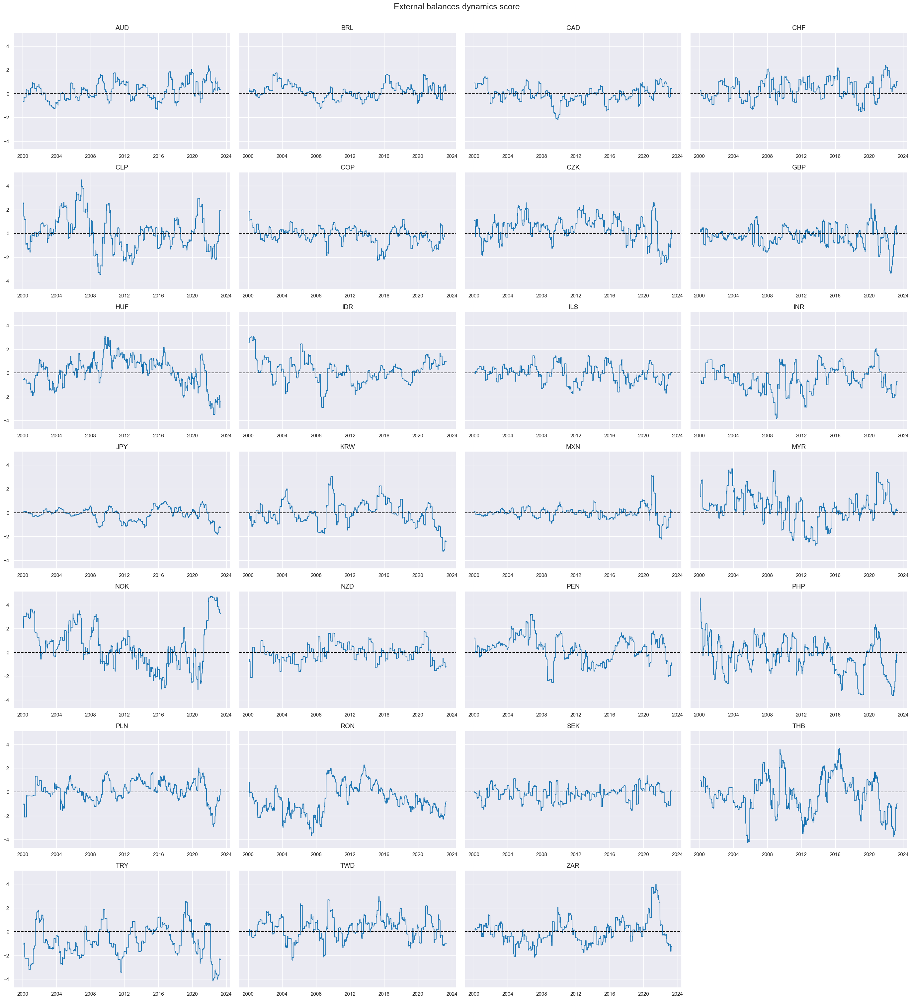

In [19]:
# xcatx = ['XST_ZC', 'XSD_ZC', 'XSTD_ZC']
xcatx = ["XSTD_ZC"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
    title="External balances dynamics score",
   
)

### FX return momentum and modification

#### Standard trend

Constructing plausible FX trend indicators is an important step in analyzing currency movements. In this notebook, we construct the following indicators:
- The cumulative sum of FX forward returns as a measure of the overall return or performance of the currency over that period. A positive cumulative sum suggests an upward trend, while a negative cumulative sum indicates a downward trend. 
- Mean of 50 and 200 days rolling average: This indicator calculates the average value of the FX rates over a rolling window of 50 and 200 days, respectively. Comparing the 50-day rolling average with the 200-day rolling average can indicate potential shifts in the trend. When the 50-day average crosses above the 200-day average, it is often considered a bullish signal, suggesting a potential uptrend, and vice versa for a bearish signal.
- Difference between 50 and 200 days means: this difference can indicate the strength or momentum of the trend. A positive difference suggests a strengthening trend, while a negative difference indicates a weakening trend. 


In [20]:
fxrs = [
    "FXXR_VT10",  # FX forward return for 10% vol target: dominant cross
    "FXXRHvGDRB_NSA",
]  # Return on FX forward, hedged against market direction risk

calcs = []
for fxr in fxrs:
    calc = [
        f"{fxr}I = ( {fxr} ).cumsum()",
        f"{fxr}I_50DMA = {fxr}I.rolling(50).mean()",
        f"{fxr}I_200DMA = {fxr}I.rolling(200).mean()",
        f"{fxr}I_50v200DMA = {fxr}I_50DMA - {fxr}I_200DMA",
    ]
    calcs += calc

dfa = msp.panel_calculator(dfx, calcs, cids=cidx, blacklist=fxblack)
dfx = msm.update_df(dfx, dfa)

Here we choose two main FX trend indicators for the analysis: 

- The difference between 50 and 200 days means for FX forward return with a 10% vol target `FXXR_VT10I_50v200DMA`: This indicator calculates the difference between the mean values of the FX forward returns over the 50-day and 200-day rolling windows. The returns used in this calculation are specific to FX forward contracts, and the indicator focuses on a 10% volatility target. Comparing the shorter-term average (50-day mean) with the longer-term average (200-day mean), gives an assessment of the relative strength or momentum of the trend.
- The difference between 50 and 200 days means for return on FX forward, hedged against market direction risk `FXXRHvGDRB_NSAI_50v200DMA`

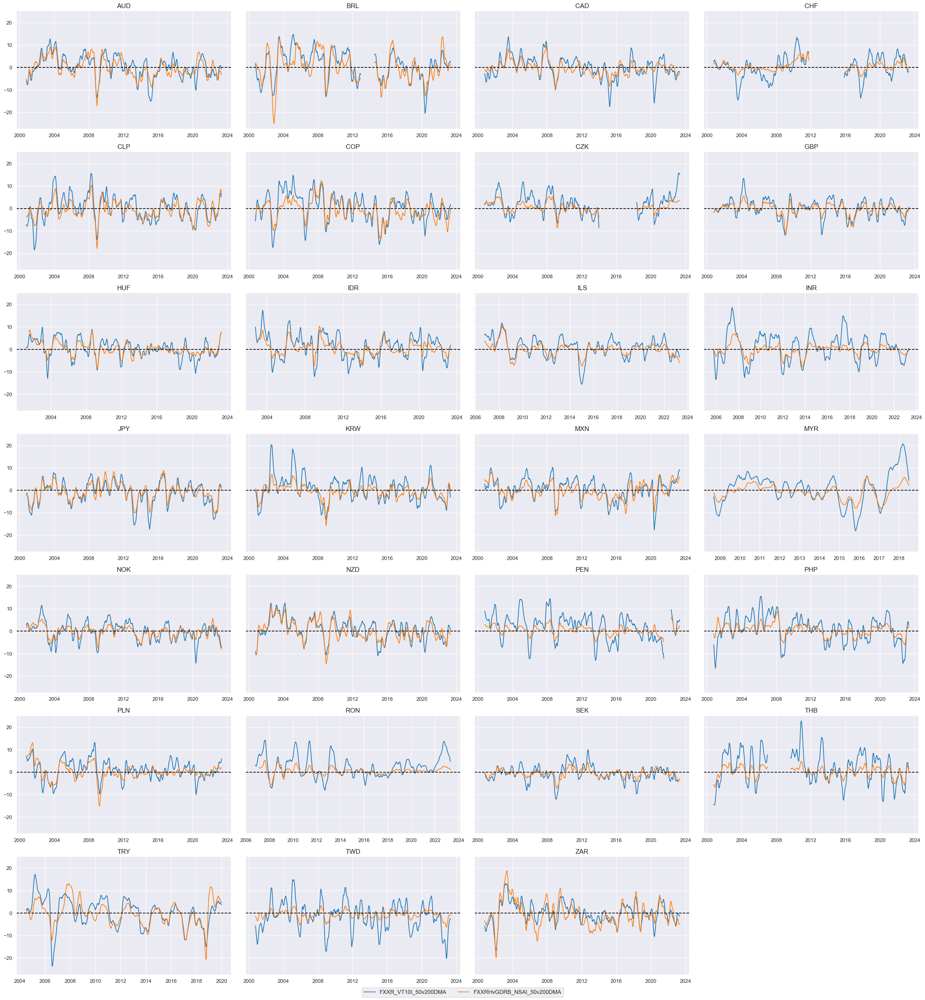

In [21]:
xcatx = ["FXXR_VT10I_50v200DMA", "FXXRHvGDRB_NSAI_50v200DMA"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
   
)

#### Modified trend

In preparation for modification, we z-score both FX trends and previously constructed external trend scores with winsorization at 3 standard deviations. We add postfix `_Z3` to distinguish it from other indicators. For future analysis, we collect the normalized FX indicators in two separate lists: FX Trends in `trendz` (`FXVTREND_Z3`, `FXHTREND_Z3`) and external ratio indicators in list `xstrengthz` (`XSD_ZC_Z3`, `XSTD_ZC_Z3`, `XST_ZC_Z3`)

In [22]:
xcatx = ["FXXR_VT10I_50v200DMA", "FXXRHvGDRB_NSAI_50v200DMA"] + xszc
cidx = cids_fx

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=522,  # oos scaling after 2 years of panel data
        est_freq="m",
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="_Z3",
    )
    dfa = msm.update_df(dfa, dfaa)

dict_rename = {
    "FXXR_VT10I_50v200DMA": "FXVTREND",
    "FXXRHvGDRB_NSAI_50v200DMA": "FXHTREND",
}
dfa["xcat"] = dfa["xcat"].replace(dict_rename, regex=True)

dfx = msm.update_df(dfx, dfa)

trendz = [tr + "_Z3" for tr in list(dict_rename.values())]
xstrengthz = [xs + "_Z3" for xs in xszc]

Next, we apply a modification, allowing for adjustments to the strength of the FX trend signal based on the quantamental information captured by the external strength z-score. The FX return trend remains the dominant signal, but we allow quantamental information to increase the trend signal by up to 100% and to reduce it by up to zero. However, quantamental information does not "flip" the signal. The modification coefficient ensures that the adjustment remains within [0,2] interval, hence preventing extreme flips or amplifications of the trend signal.

The linear modification coefficient applied to the trend is based on the external strength z-score. The application depends on the sign of the concurrent trend signal.

* If the trend signal is positive, external strength enhances it and external weakness reduces it. The modification coefficient uses a sigmoid function that translates the external strength score such that for a value of zero it is 1, for values of -1 and 1 it is 0.25 and 1.75 respectively and for its minimum and maximum of -3 and 3 it is 0 zero and 2 respectively.

* If the trend signal is negative the modification coefficient depends negatively on external strength in the same way.

This can be expressed in the following equation:

    adtrend = ((1 - sign(external ratio trend))  + sign(external ratio trend) * coef) * trend

        where sign(external ratio trend) = 1 if external ratio trend >0; -1 if external ratio trend<0, and 0 if external ratio trend =0;
        coef = 2/(1 + exp(-2 * strength))

This means for positive trend:

    adtrend = coef * external ratio trend

And this means for negative trend:

    adtrend = (2 - coef) * external ratio trend

The modification coefficient for the trend signal is determined by a logistic (sigmoid) function of the external strength z-score. The modification coefficient can range between 0 and 2. Values larger than 1 strengthen the original signal, whereas values below one reduce the original signal. 

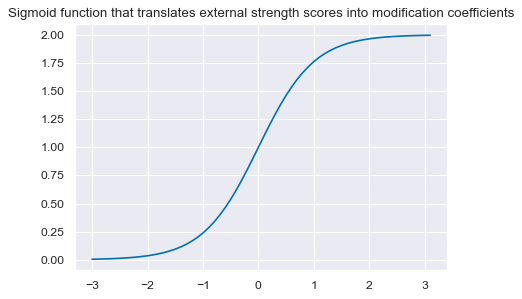

In [23]:
def sigmoid(x):
    return 2 / (1 + np.exp(-2 * x))


ar = np.arange(-3, 3.2, 0.1)
plt.figure(figsize=(6, 4), dpi=80)
plt.plot(ar, sigmoid(ar))
plt.title(
    "Sigmoid function that translates external strength scores into modification coefficients"
)
plt.show()

We calculate the modification coefficients for all external strength scores, as applicable for positive trend scores, and then apply them to the trend scores in dependence on their signs. The coefficients get an additional postfix `_C`, so we get 3 series of coefficients based on the 3 external ratio z-scores created earlier (`XSD_ZC_Z3_C`, `XSTD_ZC_Z3_C`, `XST_ZC_Z3_C`)

In [24]:
calcs = []
for zd in xstrengthz:
    calcs += [f"{zd}_C = ( {zd} ).applymap( lambda x: 2 / (1 + np.exp( - 2 * x)) ) "]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx)
dfx = msm.update_df(dfx, dfa)

coefs = list(dfa["xcat"].unique())
dfx[dfx["xcat"].isin(coefs)].head()  # to see the value of coefficients

,cid,xcat,real_date,value
6178836,AUD,XSD_ZC_Z3_C,2000-02-01,0.471269
6178837,AUD,XSD_ZC_Z3_C,2000-02-02,0.471269
6178838,AUD,XSD_ZC_Z3_C,2000-02-03,0.471269
6178839,AUD,XSD_ZC_Z3_C,2000-02-04,0.477707
6178840,AUD,XSD_ZC_Z3_C,2000-02-07,0.477707


The charts below compare the original external strength scores with the sigmoid transformation coefficients. The coefficients are used to modify the trend scores, i.e. the higher the external strength the higher the trend score. The coefficients can only vary between 0 and 2.

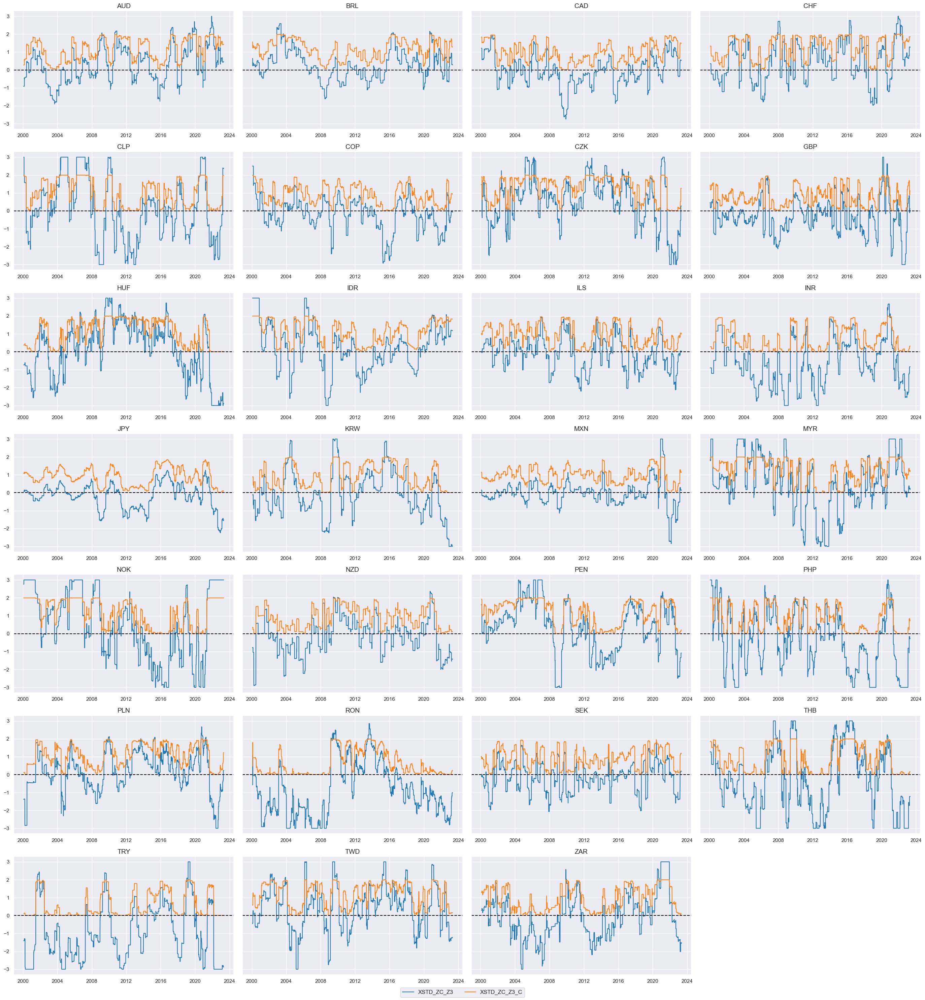

In [25]:
xcatx = ["XSTD_ZC_Z3", "XSTD_ZC_Z3_C"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
   
)

The calculation of the trend sign-contingent coefficient and adjusted trends is based on the below formula.

((1 - sign(trend))  + sign(trend) * coef) * trend.

The new indicators will have the following structure in their name:

- They will inherit `FXV` or `FXH` from the first letters of the input FX indicator  `FXVTREND_Z3` (based on the original indicator FX forward return for 10% vol target: dominant cross), and `FXHTREND_Z3` (based on the original indicator Return on FX forward, hedged against market direction risk)
- they will have `m` in the name for 'modified'
- the name will have `XSD, `XSTD`, or `XST` in its name indicating which of the external ratio indicators is used
- the coefficient names will end with `_C` postfix to indicate that it is a coefficient or no postfix to indicate the modified indicator 


For example, `FXVmXSTD_C` is a coefficient based on `FXVTREND_Z3` enhanced with Trend-dynamics external ratio scores `XSTD_ZC_Z3`. For convenience, the modified trend indicators are collected in the list `trendz_mod`

In [26]:
calcs = []
for tr in trendz:
    for xs in xstrengthz:
        trxs = tr.split("TREND")[0] + "m" + xs.split("_")[0]
        calcs += [f"{trxs}_C = (1 - np.sign( {tr} )) + np.sign( {tr} ) * {xs}_C"]
        calcs += [f"{trxs} = {trxs}_C * {tr}"]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx, blacklist=fxblack)
dfx = msm.update_df(dfx, dfa)

trendz_mod = [xc for xc in dfa["xcat"].unique() if not xc.endswith("_C")]

Here is a timeline of the coefficient for the composite indicator trend-dynamics and the modified indicator. As before, the value for the coefficient is between 0 and 2, with values below 1 mean reduction of the original signal and values above 1 mean strengthening of the original signal.

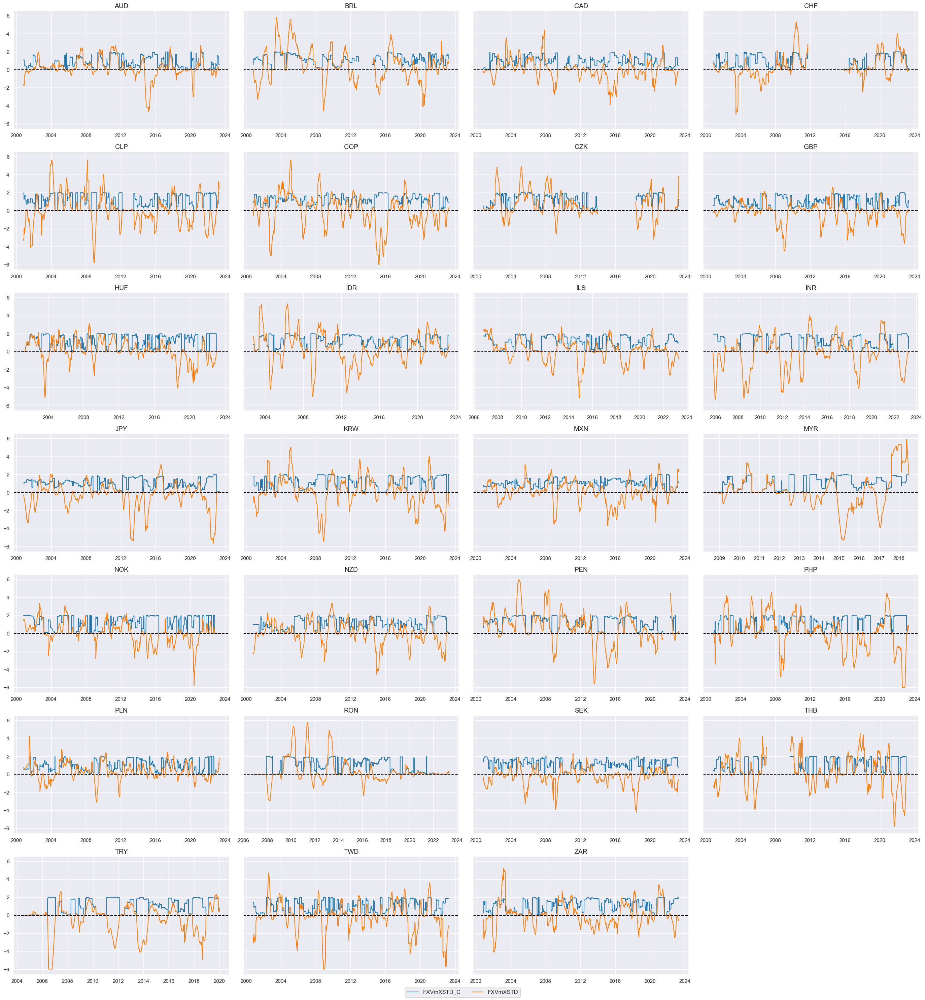

In [27]:
xcatx = ["FXVmXSTD_C", "FXVmXSTD"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  
)

Here we compare the timeline of the modified FX trend indicator with the trend indicator created by multiplying it with external ratio adjustment.

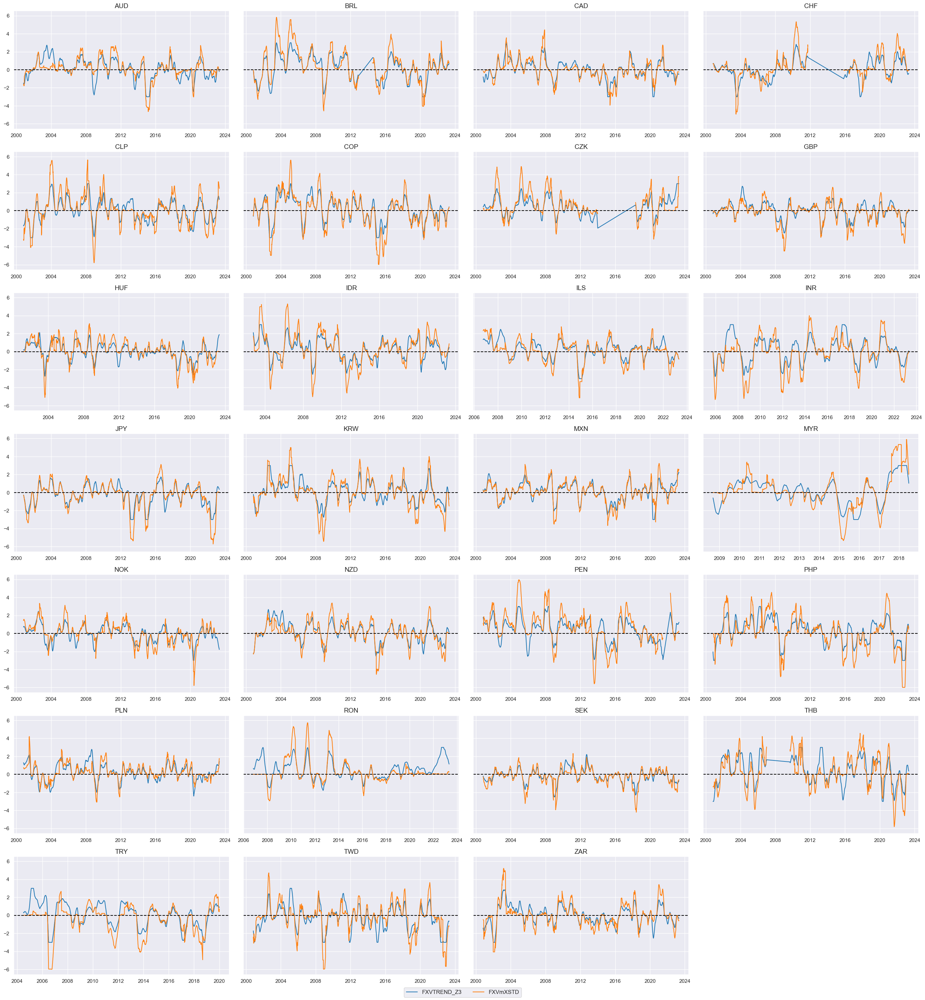

In [28]:
xcatx = ["FXVTREND_Z3", "FXVmXSTD"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
   
)

#### Balanced trend

A balanced trend here simply means that we sum up the trend and external strength z-scores. The new balanced indicators name will have the following structure:

- They will inherit `FXV` or `FXH` from the first letters of the input FX indicator  `FXVTREND_Z3` (based on the original indicator FX forward return for 10% vol target: dominant cross), and `FXHTREND_Z3` (based on the original indicator Return on FX forward, hedged against market direction risk)
- they will have `b` in the name for `balanced`
- the name will have `XSD, `XSTD`, or `XST` in its name indicating which of the external ratio indicators is used

The new balanced indicators will be collected in a list `trendz_bal` for further analysis.


In [29]:
calcs = []
for tr in trendz:
    for xs in xstrengthz:
        trxs = tr.split("TREND")[0] + "b" + xs.split("_")[0]
        calcs += [f"{trxs} = ( {tr} + {xs} ) / 2"]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx, blacklist=fxblack)
dfx = msm.update_df(dfx, dfa)

trendz_bal = [xc for xc in dfa["xcat"].unique() if not xc.endswith("_C")]

Here we compare the timelines for `FXVTREND_Z3` and the balanced indicator `FXVbXSTD`

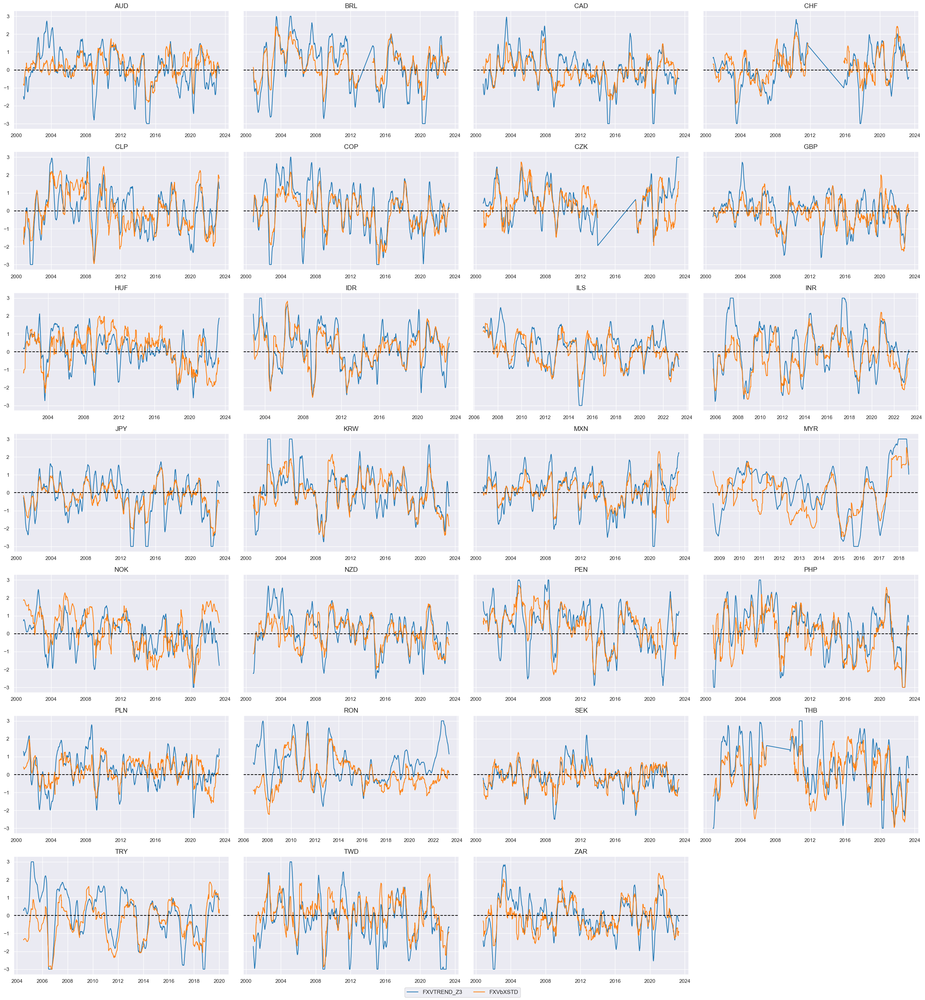

In [30]:
xcatx = ["FXVTREND_Z3", "FXVbXSTD"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  
)

### Relative scores <a id='relative_scores'></a>

Here we create relative values for original, modified, and balanced trend scores. The relative values are calculated by subtracting the mean of the score from the score itself. This is done to ensure that the model is not biased towards any particular value of the score. The name of the indicator will include `_vGFX` postfix for "versus Global FX" indicating that the average of the whole basket is taken for basis.

In [31]:
xcatx = trendz + trendz_mod + trendz_bal
dfa = msp.make_relative_value(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    start="2000-01-01",
    blacklist=fxblack,
    rel_meth="subtract",
    postfix="vGFX",
)
dfx = msm.update_df(dfx, dfa)
dfa["xcat"].unique()

array(['FXHTREND_Z3vGFX', 'FXHbXSDvGFX', 'FXHbXSTvGFX', 'FXHbXSTDvGFX',
       'FXHmXSDvGFX', 'FXHmXSTvGFX', 'FXHmXSTDvGFX', 'FXVTREND_Z3vGFX',
       'FXVbXSDvGFX', 'FXVbXSTvGFX', 'FXVbXSTDvGFX', 'FXVmXSDvGFX',
       'FXVmXSTvGFX', 'FXVmXSTDvGFX'], dtype=object)

We compare the performance of the two trends, the modified and the balanced models.

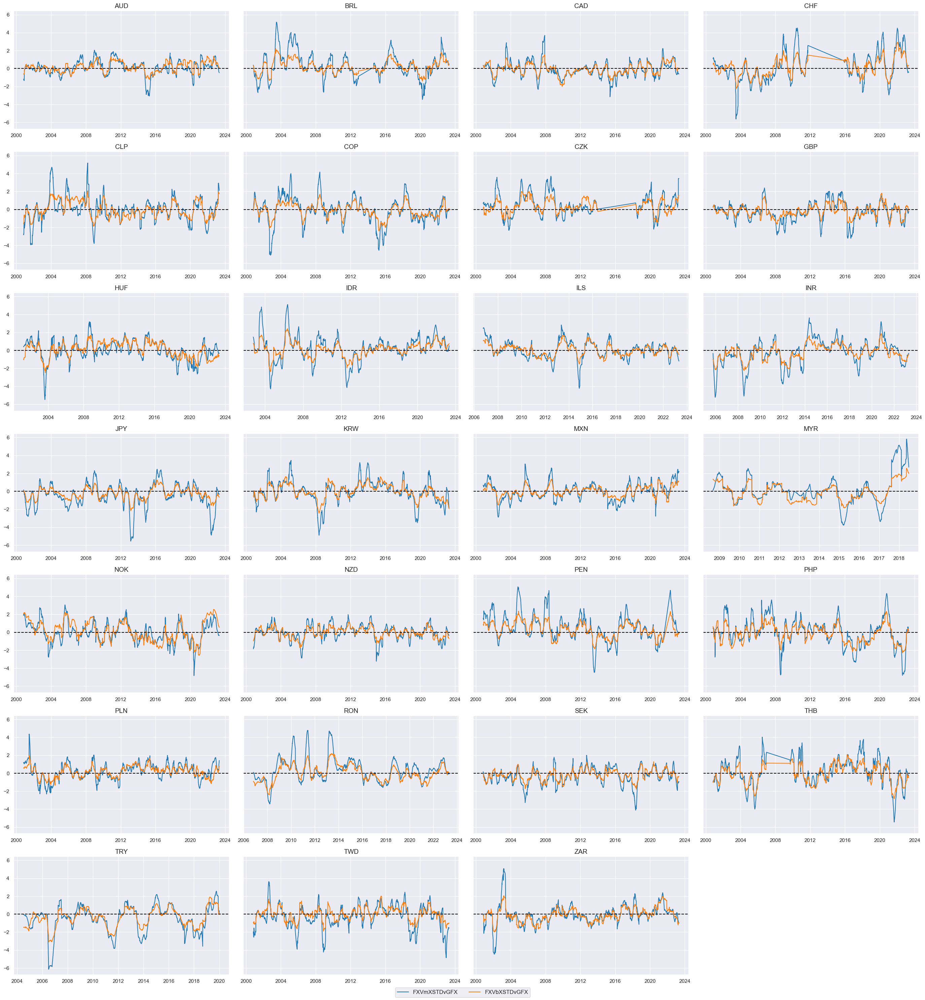

In [32]:
xcatx = ["FXVmXSTDvGFX", "FXVbXSTDvGFX"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
   )

The same relative value is calculated for each EM currency versus an EM average and postfix `vEFX` is added to these indicators.

In [33]:
xcatx = trendz + trendz_mod + trendz_bal
dfa = msp.make_relative_value(
    dfx,
    xcats=xcatx,
    cids=cids_emfx,
    start="2000-01-01",
    blacklist=fxblack,
    rel_meth="subtract",
    postfix="vEFX",
)
dfx = msm.update_df(dfx, dfa)
dfa["xcat"].unique()

array(['FXHTREND_Z3vEFX', 'FXHbXSDvEFX', 'FXHbXSTvEFX', 'FXHbXSTDvEFX',
       'FXHmXSDvEFX', 'FXHmXSTvEFX', 'FXHmXSTDvEFX', 'FXVTREND_Z3vEFX',
       'FXVbXSDvEFX', 'FXVbXSTvEFX', 'FXVbXSTDvEFX', 'FXVmXSDvEFX',
       'FXVmXSTvEFX', 'FXVmXSTDvEFX'], dtype=object)

## Targets

### Types of FX return

#### Directional vol-targeted and hedged returns

We are taking here, as before, 2 FX returns: cumulative FX forward return for 10% vol target: dominant cross `FXXR_VT10` and cumulative return on FX forward, hedged against market direction risk `FXXRHvGDRB_NSA`

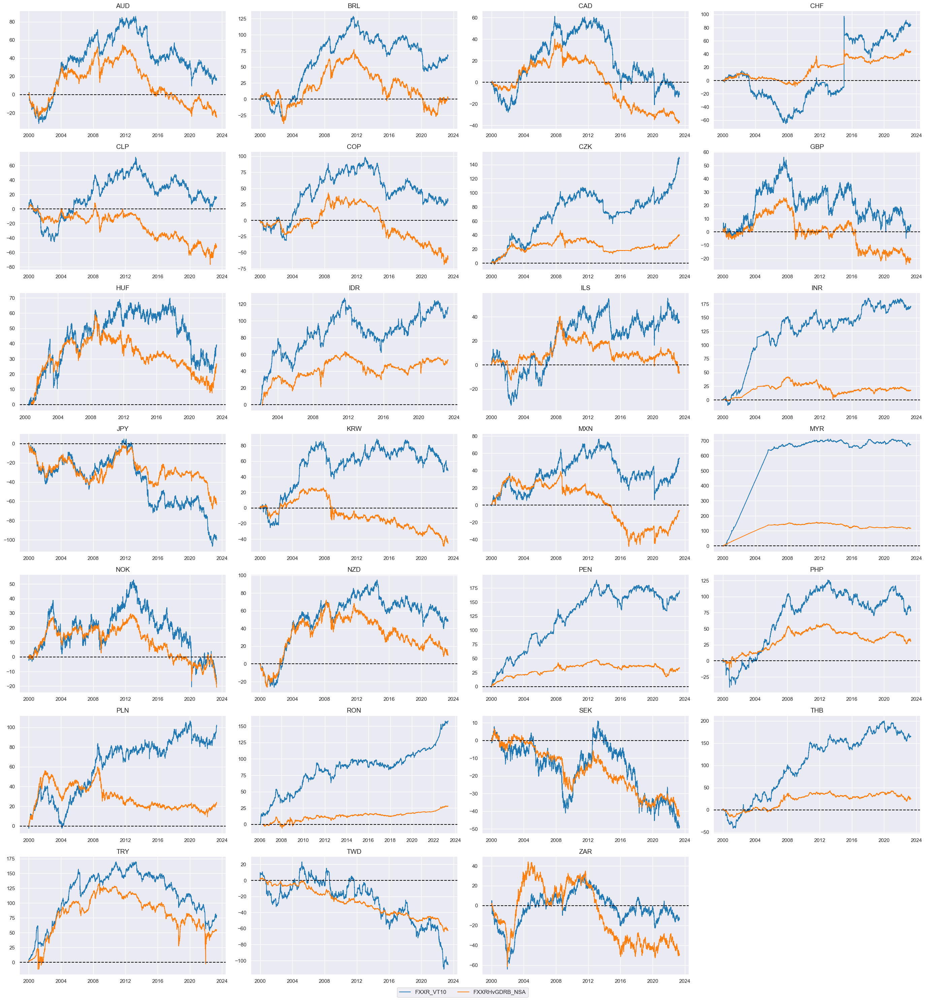

In [34]:
xcatx = ["FXXR_VT10", "FXXRHvGDRB_NSA"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title=None,
    xcat_labels=None,
)

#### Global relative returns

We calculate the relative value for unhedged and hedged FX forward returns by subtracting the panel average from each individual category.

In [35]:
xcatx = ["FXXR_VT10", "FXXRHvGDRB_NSA"]
dfa = msp.make_relative_value(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    start="2000-01-01",
    blacklist=fxblack,
    rel_meth="subtract",
    postfix="vGFX",
)
dfx = msm.update_df(dfx, dfa)

visualizing selected relative value indicators on a timeline:

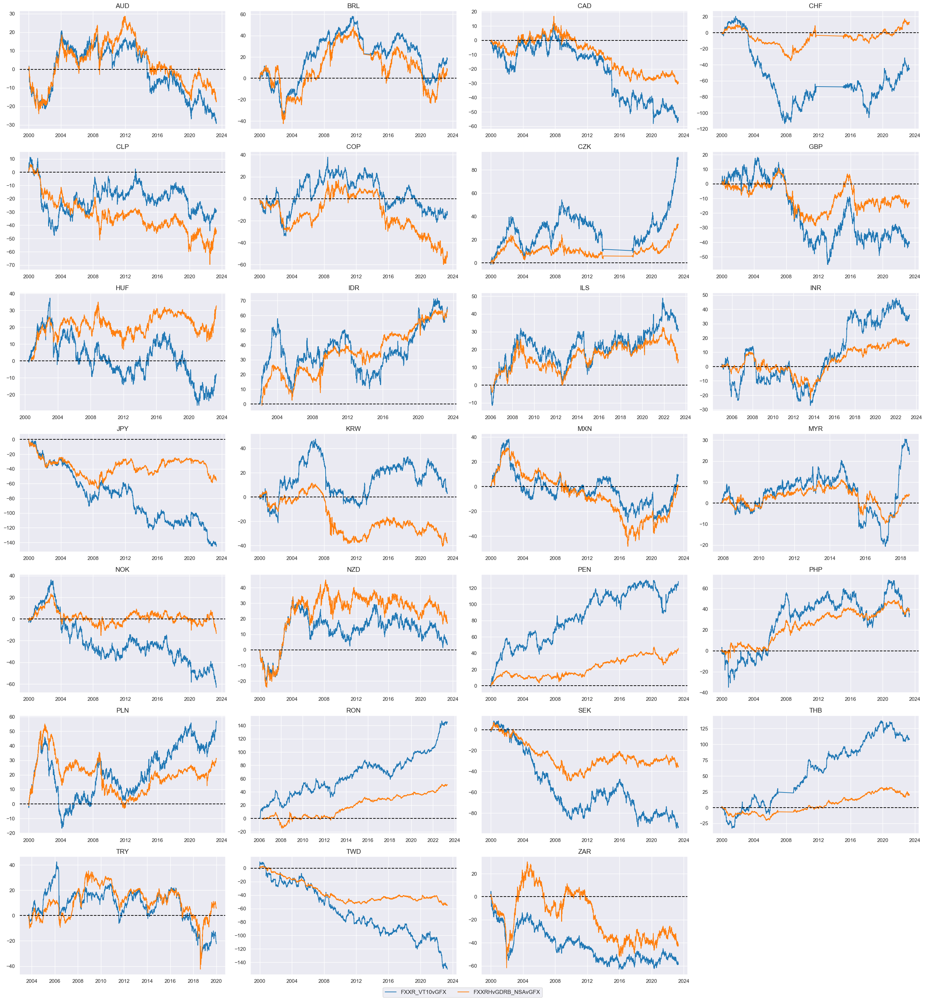

In [36]:
xcatx = ["FXXR_VT10vGFX", "FXXRHvGDRB_NSAvGFX"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title=None,
    xcat_labels=None,
)

#### EM relative returns

The same calculations can be done for emerging market currencies.

In [37]:
xcatx = ["FXXR_VT10", "FXXRHvGDRB_NSA"]
cidx = cids_emfx

dfa = msp.make_relative_value(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    start="2000-01-01",
    blacklist=fxblack,
    rel_meth="subtract",
    postfix="vEFX",
)
dfx = msm.update_df(dfx, dfa)

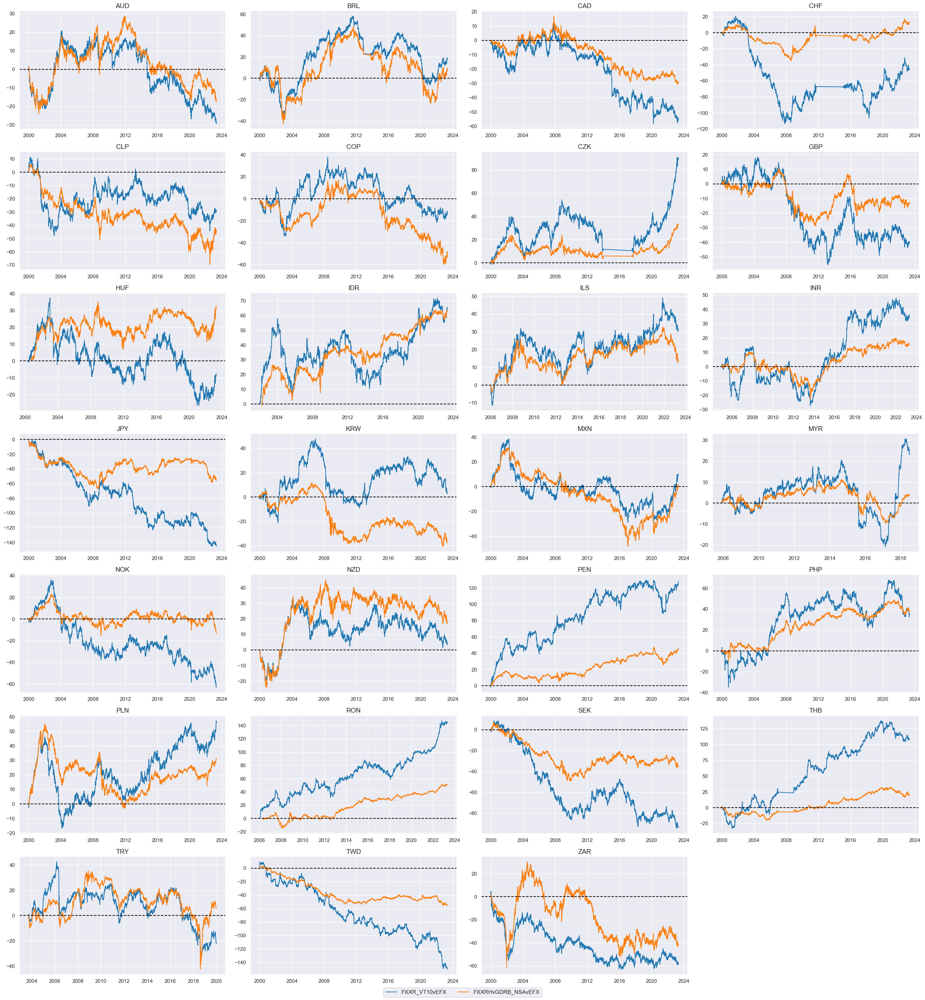

In [38]:
xcatx = ["FXXR_VT10vEFX", "FXXRHvGDRB_NSAvEFX"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title=None,
    xcat_labels=None,
)

# Value checks

## Standard trend following

### Specs and panel test

Here we specify the target variable and the list of signals (defined earlier in the list `trendz`, consisting of `FXVTREND_Z3` and `FXHTREND_Z3`) to use as predictors. As the main signal, to use later as a benchmark, we use the original z-score of unhedged FX forward return `FXVTREND_Z3` (non-modified and not-balanced)


In [39]:
sigs = trendz
ms = "FXVTREND_Z3"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10"
cidx = cids_fx

dict_trend = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

Utilizing 'CategoryRelations' function from the [Macrosynergy package](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#investigate-relations-between-panels-with-categoryrelations), we specify a lag of one month for the main signal (`FXVTREND_Z3`), frequency, start dates and apply blacklist periods to the analysis. 

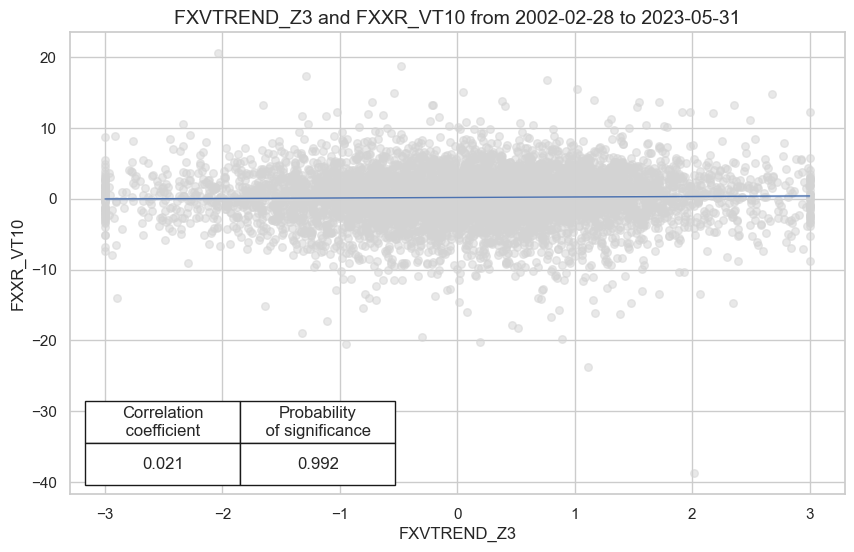

In [40]:
dix = dict_trend

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2002-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation check

Another useful function from the [Macrosynergy package](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) analyses and compares the relationships between the chosen signals and the panel of subsequent returns. There is no regression analysis involved, rather the sign of the signal is used for predicting the sign of the target.

In [41]:
dix = dict_trend

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2002-01-01",
    blacklist=blax,
)

dix["srr"] = srr

The Summary table below gives a short high-level snapshot of the strength and stability of the main signal relation.

In [42]:
dix = dict_trend
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: FXVTREND_Z3/last => FXXR_VT10,0.525,0.520,0.566,0.546,0.563,0.477,0.021,0.091,0.028,0.001,0.520
Mean cids,0.527,0.517,0.568,0.547,0.560,0.474,0.012,0.573,0.017,0.566,0.516
Mean years,0.526,0.508,0.567,0.546,0.550,0.466,-0.018,0.321,-0.002,0.348,0.506
Positive ratio,0.773,0.636,0.773,0.682,0.727,0.273,0.318,0.273,0.409,0.318,0.636
Positive ratio,0.741,0.667,0.852,0.852,0.889,0.185,0.556,0.185,0.667,0.333,0.667


The signals table gives an overview of the signal-return relationship across the main and rival signals, which produce a very similar result in our case:

In [43]:
dix = dict_trend
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXXR_VT10 FXHTREND_Z3 M         last            0.526         0.527     0.490   
          FXVTREND_Z3 M         last            0.525         0.520     0.566   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXXR_VT10 FXHTREND_Z3 M         last            0.545     0.573     0.482   
          FXVTREND_Z3 M         last            0.546     0.563     0.477   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXXR_VT10 FXHTREND_Z3 M         last           0.024         0.061    0.030   
          FXVTREND_Z3 M         last           0.021         0.091    0.028   

                                             kendall_pval    auc  
Return    Signal      Frequency Aggregation                       
FXXR_VT10 FXHTREND_Z3 M         last                0.000  0.528  
          FXVTREND_Z3 M         last                0.001  0.520

### Naive PnL

Here we calculate a daily PnL for selected signals 'FXVTREND_Z3' and  'FXHTREND_Z3'. We create a new PnL series with postfix `_PZN` to indicate that the raw signal has been transformed into z-scores.  In the cell below two PnL series are created: `FXVTREND_Z3_PZN`,  and `Long only`

In [44]:
dix = dict_trend

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )


naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

We plot both PnL series to compare with each other

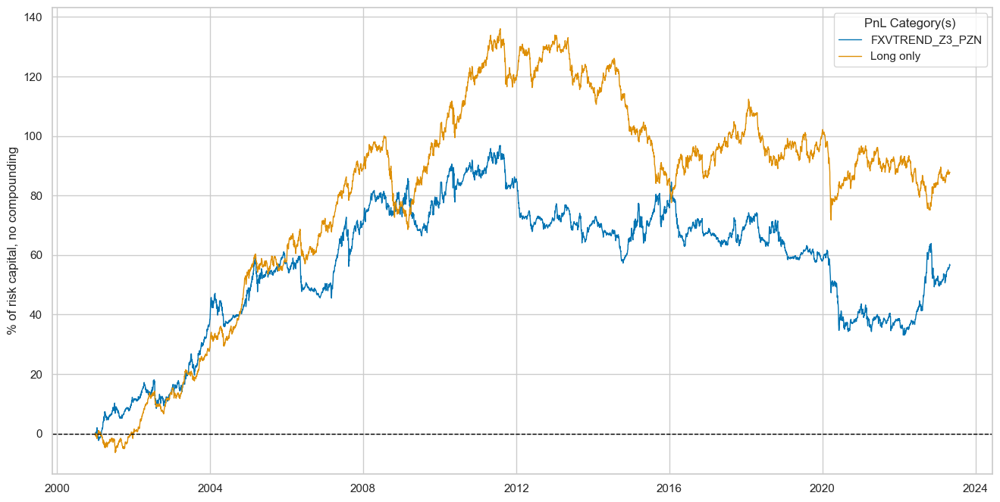

In [45]:
dix = dict_trend

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2001-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

and display basic statistics, including the return, standard deviation, and sharpe ratio

In [46]:
dix = dict_trend

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,
FXHTREND_Z3_PZN,2.725127,10.0,0.272513,0.381138,-18.697201,-22.923039,-0.037674,272
FXVTREND_Z3_PZN,2.453987,10.0,0.245399,0.331576,-15.679796,-25.190271,0.003815,272


Both original z-score FX trend indicators produce very similar statistics for the observed period. In fact, the long-only strategy seems to outperform both signals most of the time. 

## External balance strength

### Specs and panel test

Here we use external balance strength indicators as signals. The main signal will be the external balances dynamics score `XSTD_ZC_Z3` 

In [47]:
sigs = xstrengthz
ms = "XSTD_ZC_Z3"  # main signal
oths = list(set(sigs) - set([ms])) + ["FXVTREND_Z3"]  # other signals

targ = "FXXR_VT10"
cidx = cids_fx

dict_xs = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

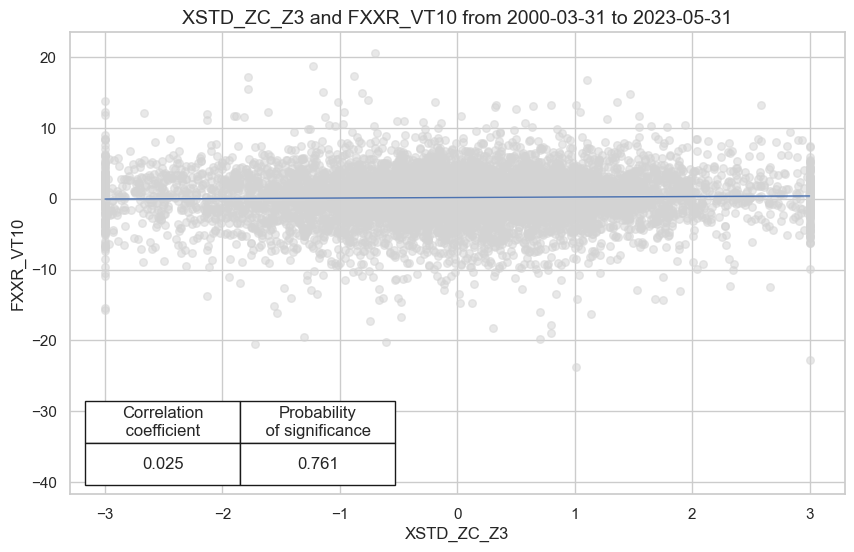

In [48]:
dix = dict_xs

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation bars

In [49]:
dix = dict_xs

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [50]:
dix = dict_xs
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: XSTD_ZC_Z3/last => FXXR_VT10,0.512,0.513,0.497,0.544,0.557,0.468,0.025,0.038,0.019,0.016,0.513
Mean cids,0.512,0.514,0.493,0.546,0.561,0.467,0.029,0.418,0.020,0.427,0.513
Mean years,0.509,0.506,0.494,0.544,0.549,0.463,0.010,0.439,0.007,0.377,0.506
Positive ratio,0.625,0.542,0.500,0.667,0.708,0.333,0.625,0.375,0.542,0.417,0.542
Positive ratio,0.630,0.667,0.370,0.889,0.778,0.185,0.630,0.444,0.667,0.481,0.667


The table below compares accuracy, balanced accuracy, positive and negative precisions for external ratio scores and for the original FX trend score. 

In [51]:
dix = dict_xs
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXXR_VT10 FXVTREND_Z3 M         last            0.528         0.523     0.558   
          XSD_ZC_Z3   M         last            0.511         0.511     0.498   
          XSTD_ZC_Z3  M         last            0.512         0.513     0.497   
          XST_ZC_Z3   M         last            0.506         0.506     0.498   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXXR_VT10 FXVTREND_Z3 M         last            0.545     0.565     0.480   
          XSD_ZC_Z3   M         last            0.544     0.555     0.467   
          XSTD_ZC_Z3  M         last            0.544     0.557     0.468   
          XST_ZC_Z3   M         last            0.544     0.551     0.462   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXXR_VT10 FXVTREND_Z3 M         last           0.024         0.048    0.032   
          XSD_ZC_Z3   M         last           0.028         0.019    0.019   
          XSTD_ZC_Z3  M         last           0.025         0.038    0.019   
          XST_ZC_Z3   M         last           0.013         0.278    0.010   

                                             kendall_pval    auc  
Return    Signal      Frequency Aggregation                       
FXXR_VT10 FXVTREND_Z3 M         last                0.000  0.523  
          XSD_ZC_Z3   M         last                0.018  0.511  
          XSTD_ZC_Z3  M         last                0.016  0.513  
          XST_ZC_Z3   M         last                0.227  0.506

### Naive PnLs

In [52]:
dix = dict_xs

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2002-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["pnls"] = naive_pnl

In this plot, we compare two PnLs based on: 
- based on the Standard 50-day versus 200 day trend score and 
- external balance dynamics score

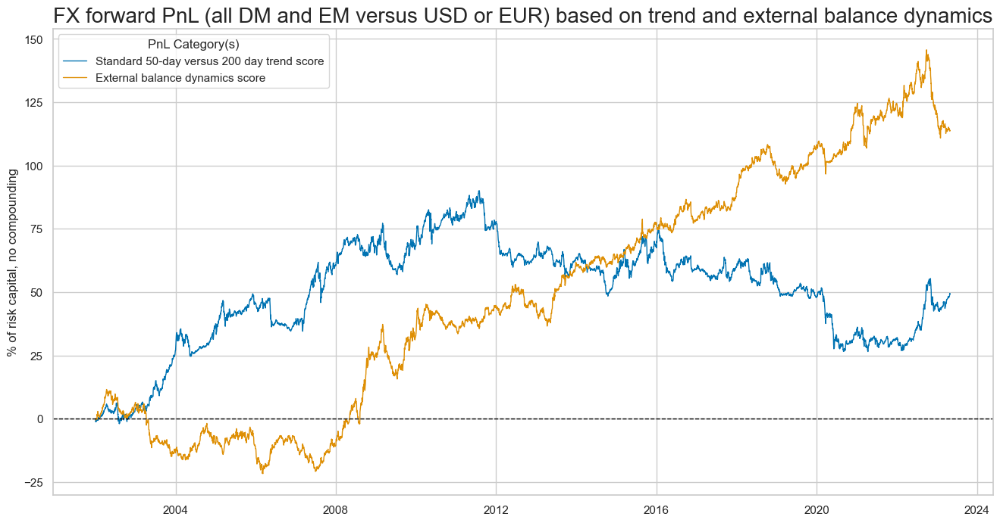

In [53]:
dix = dict_xs

sigx = ["FXVTREND_Z3"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]
dict_labels = {"FXVTREND_Z3_PZN": "Standard 50-day versus 200 day trend score", "XSTD_ZC_Z3_PZN": "External balance dynamics score"}


naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (all DM and EM versus USD or EUR) based on trend and external balance dynamics",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

These naïve PnLs suggest that the economic value of the external dynamics score (Sharpe 0.42 - see table below) has been greater than that of the trend score (Sharpe 0.19). More importantly, the two have been highly complementary. While the trend signal produced all its value in the 2000s, the external dynamics score produced consistent positive returns from 2008 to 2022.

We can also compare the performance of the trend and external balance signals in terms of their returns, Sharpe ratios, maximum 21 day draw, and correlation with the benchmark


In [54]:
dix = dict_xs

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,
FXVTREND_Z3_PZN,2.306562,10.0,0.230656,0.312546,-14.156601,-22.997252,0.010036,257
XSD_ZC_Z3_PZN,4.726869,10.0,0.472687,0.686069,-17.103325,-26.826704,-0.052146,257
XSTD_ZC_Z3_PZN,5.340808,10.0,0.534081,0.770957,-16.798019,-33.050801,-0.067693,257
XST_ZC_Z3_PZN,4.424577,10.0,0.442458,0.636455,-14.32191,-36.221508,-0.080334,257


## Modified trend following

### Specs and panel test

Here we take the modified signal `FXVmXSTD` and evaluate it in the context of the other signals. 


In [55]:
sigs = [tr for tr in trendz_mod if tr.startswith("FXV")] + ["FXVTREND_Z3"]
ms = "FXVmXSTD"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10"
cidx = cids_fx

dict_xsmod = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

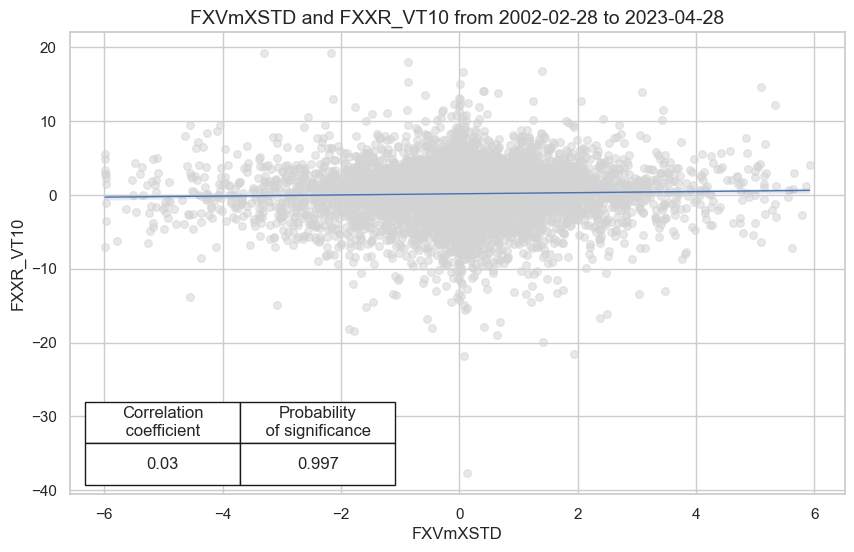

In [56]:
dix = dict_xsmod

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    slip=1,
    xcat_aggs=["last", "sum"],
    start="2002-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation bars

In [57]:
dix = dict_xsmod

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2002-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [58]:
dix = dict_xsmod
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: FXVmXSTD/last => FXXR_VT10,0.525,0.520,0.566,0.546,0.563,0.477,0.030,0.015,0.030,0.000,0.520
Mean cids,0.527,0.517,0.568,0.547,0.560,0.474,0.018,0.505,0.021,0.533,0.516
Mean years,0.526,0.508,0.567,0.546,0.550,0.466,-0.009,0.593,0.005,0.479,0.506
Positive ratio,0.773,0.636,0.773,0.682,0.727,0.273,0.455,0.136,0.545,0.318,0.636
Positive ratio,0.741,0.667,0.852,0.852,0.889,0.185,0.593,0.333,0.704,0.222,0.667


In [59]:
dix = dict_xsmod
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXXR_VT10 FXVTREND_Z3 M         last            0.525          0.52     0.566   
          FXVmXSD     M         last            0.525          0.52     0.566   
          FXVmXST     M         last            0.525          0.52     0.566   
          FXVmXSTD    M         last            0.525          0.52     0.566   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXXR_VT10 FXVTREND_Z3 M         last            0.546     0.563     0.477   
          FXVmXSD     M         last            0.546     0.563     0.477   
          FXVmXST     M         last            0.546     0.563     0.477   
          FXVmXSTD    M         last            0.546     0.563     0.477   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXXR_VT10 FXVTREND_Z3 M         last           0.021         0.091    0.028   
          FXVmXSD     M         last           0.029         0.020    0.030   
          FXVmXST     M         last           0.024         0.058    0.027   
          FXVmXSTD    M         last           0.030         0.015    0.030   

                                             kendall_pval   auc  
Return    Signal      Frequency Aggregation                      
FXXR_VT10 FXVTREND_Z3 M         last                0.001  0.52  
          FXVmXSD     M         last                0.000  0.52  
          FXVmXST     M         last                0.001  0.52  
          FXVmXSTD    M         last                0.000  0.52

### Naive PnL

In [60]:
dix = dict_xsmod

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2002-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA", "EUR_FXXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["pnls"] = naive_pnl

As before, we plot two PnL series: the unmodified FX-forward PnL "FXVTREND_Z3_PZN" and modified with external balance dynamics PnL `FXVmXSTD_PZN`. The naïve PnL comparison shows that modification prevented most of the losses that trend following incurred in the 2010s, lifting the long-term Sharpe to 0.3 from 0.2.

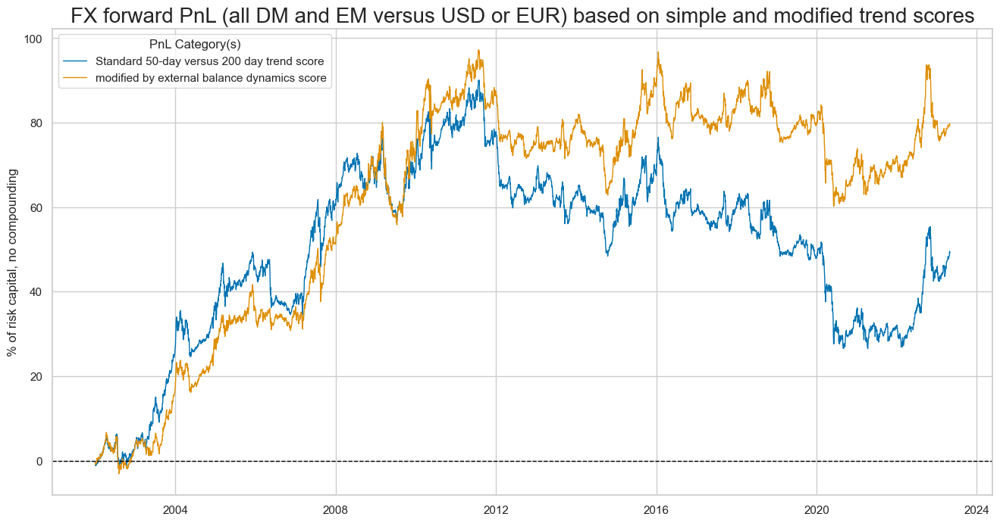

In [61]:
dix = dict_xsmod

sigx = ["FXVTREND_Z3"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]
dict_labels = {"FXVTREND_Z3_PZN": "Standard 50-day versus 200 day trend score", "FXVmXSTD_PZN": "modified by external balance dynamics score"}


naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (all DM and EM versus USD or EUR) based on simple and modified trend scores",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

The economic benefit of using the modified trend compared with the simple trend is notable if only since 2012, the modification prevented most of the losses that the trend following incurred in the 2010s, lifting the long-term Sharpe to 0.3 from 0.2.

In [62]:
dix = dict_xsmod

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,EUR_FXXR_NSA correl,Traded Months
xcat,,,,,,,,,
FXVTREND_Z3_PZN,2.306562,10.0,0.230656,0.312546,-14.156601,-22.997252,0.010036,0.046052,257
FXVmXSD_PZN,3.56697,10.0,0.356697,0.493007,-16.807337,-20.732494,0.004987,0.018271,257
FXVmXSTD_PZN,3.727478,10.0,0.372748,0.515989,-16.075787,-22.348609,-0.005563,0.010198,257
FXVmXST_PZN,3.091182,10.0,0.309118,0.423783,-15.053487,-23.822011,-0.012537,0.014551,257


## Balanced trend following

### Specs and panel test

The alternative to a modified trend is a balanced trend. We use `FXVbXSTD` indicator, the average of the trend z-score and the external balance dynamics z-score. The effect of doing so would have been similar to trend modification, albeit a little more pronounced. 

In [63]:
sigs = [tr for tr in trendz_bal if tr.startswith("FXV")] + ["FXVTREND_Z3"]
ms = "FXVbXSTD"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10"
cidx = cids_fx

dict_xsbal = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

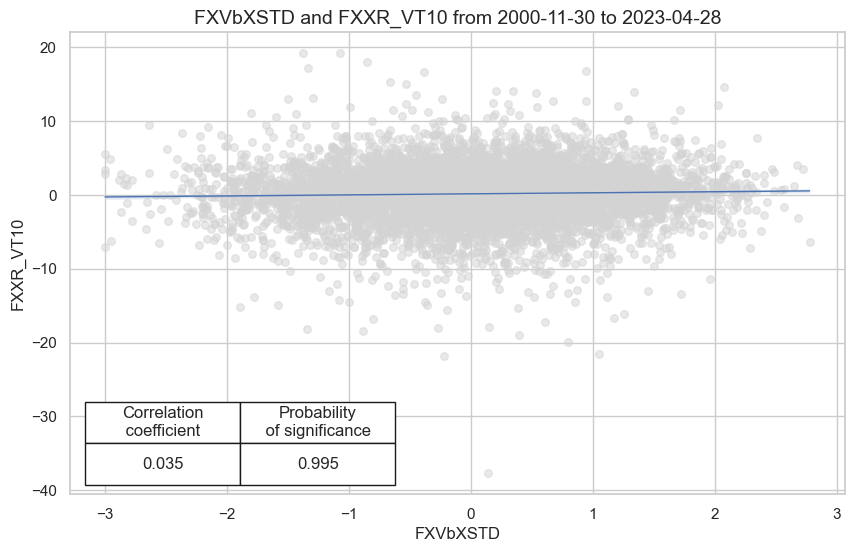

In [64]:
dix = dict_xsbal

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    slip=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation bars

In [65]:
dix = dict_xsbal

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [66]:
dix = dict_xsbal
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: FXVbXSTD/last => FXXR_VT10,0.519,0.517,0.526,0.545,0.561,0.473,0.035,0.004,0.029,0.000,0.517
Mean cids,0.520,0.517,0.524,0.547,0.563,0.470,0.028,0.498,0.021,0.469,0.516
Mean years,0.519,0.506,0.520,0.544,0.549,0.463,0.001,0.646,0.006,0.573,0.506
Positive ratio,0.625,0.583,0.500,0.667,0.750,0.333,0.500,0.125,0.625,0.250,0.583
Positive ratio,0.778,0.667,0.593,0.852,0.852,0.296,0.630,0.370,0.667,0.296,0.667


Interestingly, balancing the trend signal would have reduced monthly accuracy and balanced accuracy of return predictions relative to simple trend following but significantly increased economic trading value as seen on the plot below.

In [67]:
dix = dict_xsbal
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXXR_VT10 FXVTREND_Z3 M         last            0.528         0.523     0.558   
          FXVbXSD     M         last            0.517         0.515     0.527   
          FXVbXST     M         last            0.518         0.515     0.533   
          FXVbXSTD    M         last            0.519         0.517     0.526   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXXR_VT10 FXVTREND_Z3 M         last            0.545     0.565     0.480   
          FXVbXSD     M         last            0.545     0.559     0.470   
          FXVbXST     M         last            0.545     0.559     0.471   
          FXVbXSTD    M         last            0.545     0.561     0.473   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXXR_VT10 FXVTREND_Z3 M         last           0.024         0.048    0.032   
          FXVbXSD     M         last           0.036         0.004    0.030   
          FXVbXST     M         last           0.028         0.023    0.023   
          FXVbXSTD    M         last           0.035         0.004    0.029   

                                             kendall_pval    auc  
Return    Signal      Frequency Aggregation                       
FXXR_VT10 FXVTREND_Z3 M         last                0.000  0.523  
          FXVbXSD     M         last                0.000  0.515  
          FXVbXST     M         last                0.004  0.515  
          FXVbXSTD    M         last                0.000  0.517

### Naive PnL

In [68]:
dix = dict_xsbal

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["pnls"] = naive_pnl

In [69]:
dix = dict_xsbal

sigx = ["FXVTREND_Z3"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]
pnls

['FXVTREND_Z3_PZN', 'FXVbXSTD_PZN']

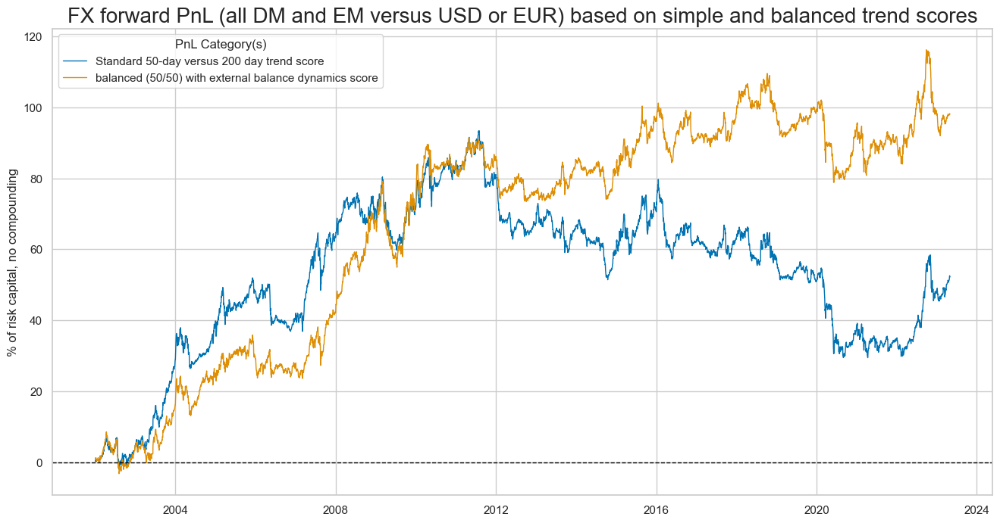

In [70]:
dix = dict_xsbal

sigx = ["FXVTREND_Z3"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

dict_labels = {"FXVTREND_Z3_PZN": "Standard 50-day versus 200 day trend score", "FXVbXSTD_PZN": "balanced (50/50) with external balance dynamics score"}


naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (all DM and EM versus USD or EUR) based on simple and balanced trend scores",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

In [71]:
dix = dict_xsbal

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,
FXVTREND_Z3_PZN,2.830278,10.0,0.283028,0.384001,-14.378075,-23.062177,0.00818,272
FXVbXSD_PZN,4.349268,10.0,0.434927,0.60919,-16.916956,-20.567052,-0.01662,272
FXVbXSTD_PZN,4.440411,10.0,0.444041,0.621734,-15.309213,-21.450489,-0.024549,272
FXVbXST_PZN,3.702437,10.0,0.370244,0.512505,-15.049596,-25.50882,-0.025707,272


Macro balancing has been essential for trend-following in emerging market currencies. This is plausible since external deficits more often contribute to disruptions of capital flows in the EM space. 

In [72]:
dix = dict_xsbal

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = cids_emfx  # focus on EM alone
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2002-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["epnls"] = naive_pnl

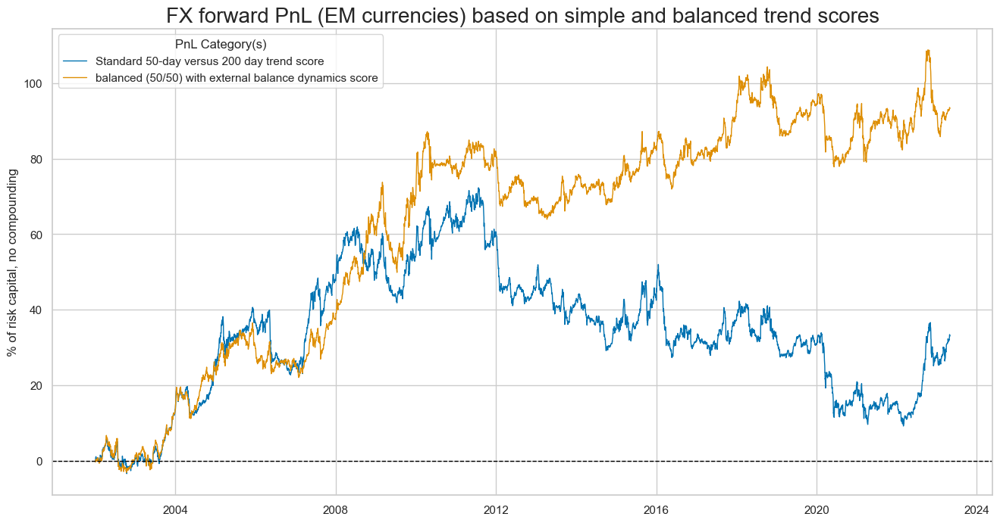

In [73]:
dix = dict_xsbal

sigx = ["FXVTREND_Z3"] + [dix["sig"]]
naive_pnl = dix["epnls"]
pnls = [sig + "_PZN" for sig in sigx]
dict_labels={"FXVTREND_Z3_PZN": "Standard 50-day versus 200 day trend score", "FXVbXSTD_PZN": "balanced (50/50) with external balance dynamics score"}



naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (EM currencies) based on simple and balanced trend scores",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

Simple trend following hardly produced any value over the last 20 years in directional EM trading, while balanced trend following at least held on to its boom-time gains during the 2010s and early 2020s.

## Relative balanced trend following

In this section, we investigate the performance of the relative values for original, modified, and balanced trend score signals. “Relative” means that the original value is compared to a basket average. By default, the basket consists of all available cross-sections. We also consider separately emerging markets.

### Specs and panel test

Here we use the relative value trend `FXVTREND_Z3vGFX` as the main signal.

In [74]:
sigs = [tr + "vGFX" for tr in trendz_bal if tr.startswith("FXV")] + ["FXVTREND_Z3vGFX"]
ms = "FXVbXSTDvGFX"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10vGFX"
cidx = cids_fx

dict_xsbar = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

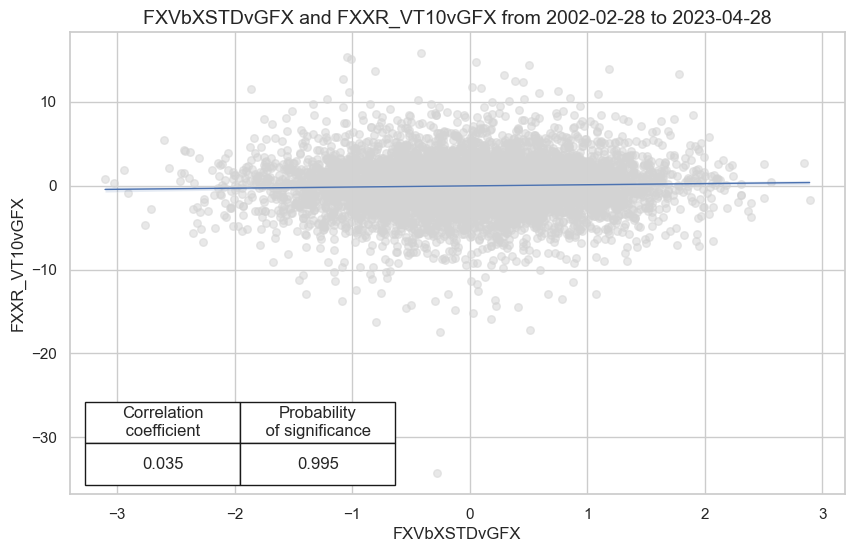

In [75]:
dix = dict_xsbar

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    slip=1,
    xcat_aggs=["last", "sum"],
    start="2002-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation bars

In [76]:
dix = dict_xsbar

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2002-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [77]:
dix = dict_xsbar
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: FXVbXSTDvGFX/last => FXXR_VT10vGFX,0.520,0.520,0.505,0.508,0.528,0.512,0.035,0.005,0.027,0.001,0.520
Mean cids,0.520,0.519,0.504,0.510,0.528,0.510,0.031,0.445,0.019,0.416,0.518
Mean years,0.522,0.522,0.505,0.509,0.529,0.514,0.034,0.477,0.029,0.399,0.522
Positive ratio,0.727,0.727,0.591,0.636,0.682,0.636,0.773,0.455,0.773,0.545,0.727
Positive ratio,0.741,0.741,0.444,0.630,0.630,0.481,0.778,0.370,0.704,0.370,0.741


In [78]:
dix = dict_xsbar
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  \
Return        Signal          Frequency Aggregation                           
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last            0.513         0.513   
              FXVbXSDvGFX     M         last            0.515         0.515   
              FXVbXSTDvGFX    M         last            0.520         0.520   
              FXVbXSTvGFX     M         last            0.514         0.514   

                                                     pos_sigr  pos_retr  \
Return        Signal          Frequency Aggregation                       
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last            0.496     0.508   
              FXVbXSDvGFX     M         last            0.501     0.508   
              FXVbXSTDvGFX    M         last            0.505     0.508   
              FXVbXSTvGFX     M         last            0.499     0.508   

                                                     pos_prec  neg_prec  \
Return        Signal          Frequency Aggregation                       
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last            0.521     0.505   
              FXVbXSDvGFX     M         last            0.523     0.507   
              FXVbXSTDvGFX    M         last            0.528     0.512   
              FXVbXSTvGFX     M         last            0.522     0.506   

                                                     pearson  pearson_pval  \
Return        Signal          Frequency Aggregation                          
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last           0.035         0.006   
              FXVbXSDvGFX     M         last           0.037         0.003   
              FXVbXSTDvGFX    M         last           0.035         0.005   
              FXVbXSTvGFX     M         last           0.027         0.030   

                                                     kendall  kendall_pval  \
Return        Signal          Frequency Aggregation                          
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last           0.026         0.002   
              FXVbXSDvGFX     M         last           0.027         0.001   
              FXVbXSTDvGFX    M         last           0.027         0.001   
              FXVbXSTvGFX     M         last           0.022         0.009   

                                                       auc  
Return        Signal          Frequency Aggregation         
FXXR_VT10vGFX FXVTREND_Z3vGFX M         last         0.513  
              FXVbXSDvGFX     M         last         0.515  
              FXVbXSTDvGFX    M         last         0.520  
              FXVbXSTvGFX     M         last         0.514

### Naive PnL

In [79]:
dix = dict_xsbar

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2002-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["pnls"] = naive_pnl

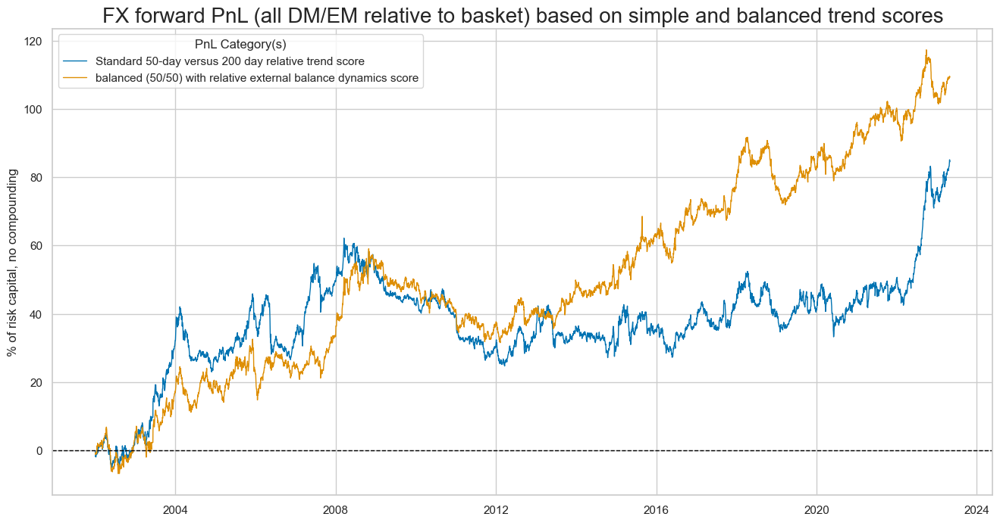

In [80]:
dix = dict_xsbar

sigx = ["FXVTREND_Z3vGFX"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

dict_labels={"FXVTREND_Z3vGFX_PZN": "Standard 50-day versus 200 day relative trend score", "FXVbXSTDvGFX_PZN": "balanced (50/50) with relative external balance dynamics score"}


naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (all DM/EM relative to basket) based on simple and balanced trend scores",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

A balanced trend following strategy would have produced a higher naïve PnL value with less seasonality when applied to relative FX forward positions, i.e., trends and returns of any of 27 currencies versus a basket of all currencies. A balanced trend score would have delivered a Sharpe ratio of roughly 0.37.

In [81]:
dix = dict_xsbar

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,
FXVTREND_Z3vGFX_PZN,3.963213,10.0,0.396321,0.55511,-16.822991,-17.572935,-0.007883,257
FXVbXSDvGFX_PZN,5.276129,10.0,0.527613,0.759222,-11.882721,-17.51199,-0.024943,257
FXVbXSTDvGFX_PZN,5.124991,10.0,0.512499,0.73643,-11.995799,-17.895863,-0.023509,257
FXVbXSTvGFX_PZN,4.176944,10.0,0.417694,0.599308,-12.736294,-16.675704,-0.016055,257


## Relative balanced EM trend following

The post argues, that macro balancing particularly in the context of trend-following in emerging market (EM) currencies, has been considered crucial. This is due to the fact that external deficits tend to play a significant role in causing disruptions to capital flows in the EM space. Simple trend following strategies have generally not been as effective in generating substantial returns in directional EM trading over the past two decades. However, balanced trend following approaches have demonstrated the ability to preserve gains made during periods of market booms, specifically in the 2010s and early 2020s.

### Specs and panel test

Here we use the relative indicator `FXVbXSTDvEFX` created earlier as relative to emerging markets currencies basket

In [82]:
sigs = [tr + "vEFX" for tr in trendz_bal if tr.startswith("FXV")] + ["FXVTREND_Z3vEFX"]
ms = "FXVbXSTDvEFX"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10vEFX"
cidx = cids_emfx

dict_xsbae = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

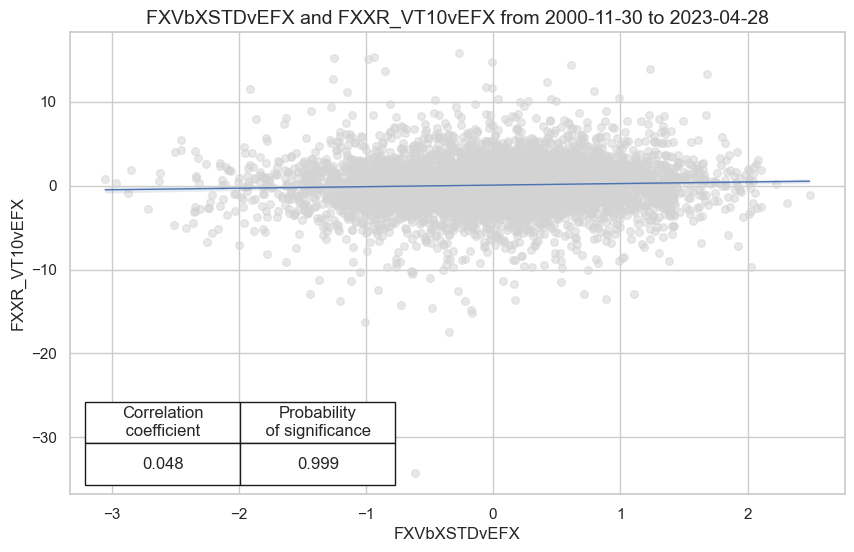

In [83]:
dix = dict_xsbae

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="M",
    lag=1,
    slip=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2010,
    xlab=None,
    ylab=None,
    title=None,
    size=(10, 6),
    prob_est="map",
)

### Accuracy and correlation bars

In [84]:
dix = dict_xsbae

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2002-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [85]:
dix = dict_xsbae
srrx = dix["srr"]
display(srrx.summary_table().sort_index().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: FXVbXSTDvEFX/last => FXXR_VT10vEFX,0.523,0.523,0.508,0.527,0.550,0.496,0.049,0.001,0.037,0.000,0.523
Mean cids,0.523,0.524,0.504,0.529,0.553,0.494,0.053,0.447,0.036,0.403,0.523
Mean years,0.524,0.524,0.506,0.530,0.553,0.495,0.049,0.420,0.039,0.377,0.524
Positive ratio,0.727,0.727,0.545,0.727,0.773,0.455,0.818,0.500,0.818,0.636,0.727
Positive ratio,0.842,0.842,0.526,0.842,0.842,0.421,0.895,0.474,0.895,0.474,0.842


In [86]:
dix = dict_xsbae
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  \
Return        Signal          Frequency Aggregation                           
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last            0.516         0.515   
              FXVbXSDvEFX     M         last            0.522         0.522   
              FXVbXSTDvEFX    M         last            0.523         0.523   
              FXVbXSTvEFX     M         last            0.515         0.515   

                                                     pos_sigr  pos_retr  \
Return        Signal          Frequency Aggregation                       
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last            0.507     0.527   
              FXVbXSDvEFX     M         last            0.503     0.527   
              FXVbXSTDvEFX    M         last            0.508     0.527   
              FXVbXSTvEFX     M         last            0.507     0.527   

                                                     pos_prec  neg_prec  \
Return        Signal          Frequency Aggregation                       
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last            0.542     0.488   
              FXVbXSDvEFX     M         last            0.549     0.495   
              FXVbXSTDvEFX    M         last            0.550     0.496   
              FXVbXSTvEFX     M         last            0.542     0.488   

                                                     pearson  pearson_pval  \
Return        Signal          Frequency Aggregation                          
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last           0.036         0.018   
              FXVbXSDvEFX     M         last           0.056         0.000   
              FXVbXSTDvEFX    M         last           0.049         0.001   
              FXVbXSTvEFX     M         last           0.031         0.040   

                                                     kendall  kendall_pval  \
Return        Signal          Frequency Aggregation                          
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last           0.030         0.003   
              FXVbXSDvEFX     M         last           0.041         0.000   
              FXVbXSTDvEFX    M         last           0.037         0.000   
              FXVbXSTvEFX     M         last           0.025         0.014   

                                                       auc  
Return        Signal          Frequency Aggregation         
FXXR_VT10vEFX FXVTREND_Z3vEFX M         last         0.515  
              FXVbXSDvEFX     M         last         0.522  
              FXVbXSTDvEFX    M         last         0.523  
              FXVbXSTvEFX     M         last         0.515

### Naive PnL

In [87]:
dix = dict_xsbae

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2002-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=2,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

dix["pnls"] = naive_pnl

The importance of external balance adjustment has turned out to be greater for the EM space, where a balanced trend score would have produced a long-term naïve Sharpe ratio of 0.48 and more consistent value generation than a simple trend score.

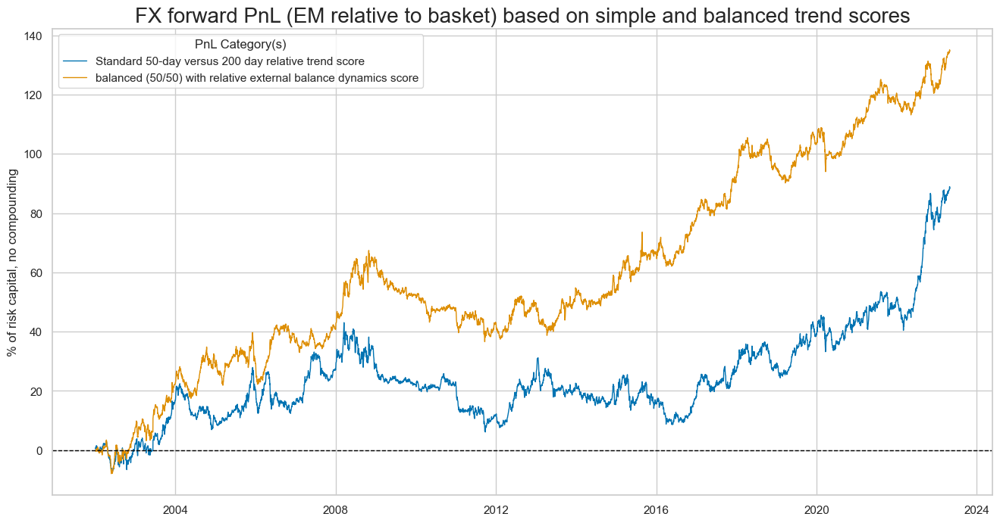

In [88]:
dix = dict_xsbae

sigx = ["FXVTREND_Z3vEFX"] + [dix["sig"]]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

dict_labels={"FXVTREND_Z3vEFX_PZN": "Standard 50-day versus 200 day relative trend score", "FXVbXSTDvEFX_PZN": "balanced (50/50) with relative external balance dynamics score"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2002-01-01",
    title="FX forward PnL (EM relative to basket) based on simple and balanced trend scores",
    xcat_labels=dict_labels,
    figsize=(16, 8),
)

In [89]:
dix = dict_xsbae

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return (pct ar),St. Dev. (pct ar),Sharpe Ratio,Sortino Ratio,Max 21-day draw,Max 6-month draw,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,
FXVTREND_Z3vEFX_PZN,4.142021,10.0,0.414202,0.583177,-12.448781,-15.573091,0.009675,257
FXVbXSDvEFX_PZN,7.152467,10.0,0.715247,1.038707,-10.437168,-12.498355,0.005614,257
FXVbXSTDvEFX_PZN,6.314229,10.0,0.631423,0.913442,-12.504302,-14.113124,0.014737,257
FXVbXSTvEFX_PZN,4.005599,10.0,0.40056,0.574258,-16.934305,-16.203378,0.020306,257
